# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.003
scheduler_gamma = [0.6, 0.6, 0.5, 0.6, 0.6, 0.5, 0.5]
scheduler_milestones = [25, 50, 100, 150, 200, 250, 400]
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones,
                               use_generative_bias=use_generative_bias)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.test_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                             df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                             rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
validation = False 
data = summary_models.run_evaluation_get_n(n=100, worst=False, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


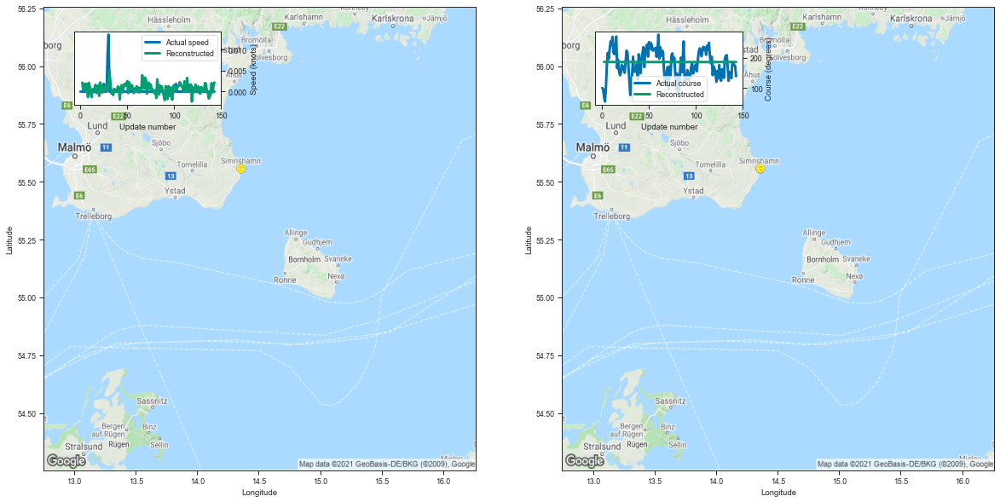

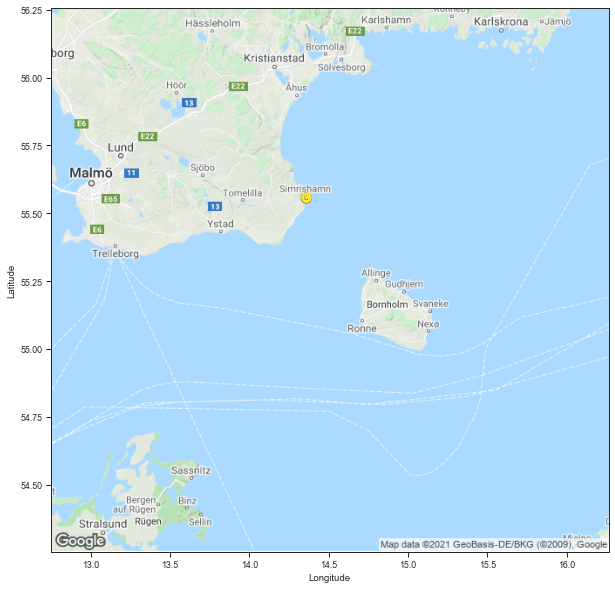

     Data set Index    Index       MMSI  Longitude   Latitude  Speed  \
0                 0  7367080  266054000  14.358097  55.556145    0.0   
1                 0  7367080  266054000  14.358096  55.556149    0.0   
2                 0  7367080  266054000  14.358092  55.556145    0.0   
3                 0  7367080  266054000  14.358094  55.556152    0.0   
4                 0  7367080  266054000  14.358078  55.556141    0.0   
..              ...      ...        ...        ...        ...    ...   
139               0  7367080  266054000  14.358113  55.556152    0.0   
140               0  7367080  266054000  14.358089  55.556137    0.0   
141               0  7367080  266054000  14.358088  55.556152    0.0   
142               0  7367080  266054000  14.358085  55.556137    0.0   
143               0  7367080  266054000  14.358074  55.556129    0.0   

         Course Ship type  Track length          Time stamp  
0    100.419998   Fishing           144 2019-08-30 00:00:03  
1     97.03

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.359165,55.556564,0.002140,186.717773,0.001322,0.001304,0.005987,91.501948
3,14.358917,55.558037,0.000439,186.702560,0.001025,0.000957,0.006598,97.277506
4,14.359635,55.557564,0.000698,186.647217,0.000914,0.000849,0.005852,98.529382
5,14.360274,55.556904,0.001880,186.563187,0.000824,0.000767,0.004348,98.662580
6,14.358994,55.558281,0.000099,186.484589,0.000750,0.000705,0.003234,98.495132
...,...,...,...,...,...,...,...,...
139,14.359432,55.557510,-0.000643,186.412628,0.000683,0.000643,0.002518,98.715040
140,14.359842,55.557240,0.002011,186.524002,0.000764,0.000708,0.003739,99.256937
141,14.359347,55.557693,-0.000182,186.524628,0.000770,0.000717,0.003743,99.017187
142,14.359544,55.558254,0.001301,186.542877,0.000789,0.000732,0.004069,99.111364


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(0)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


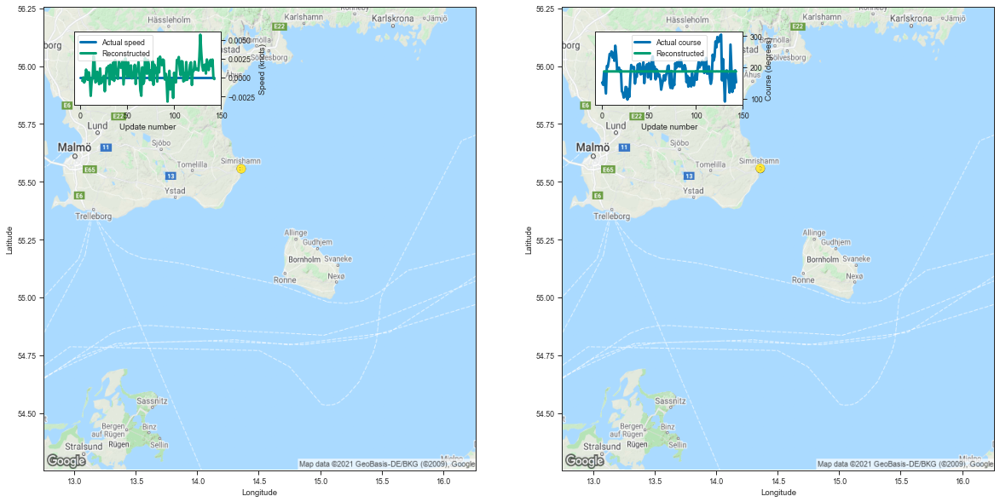

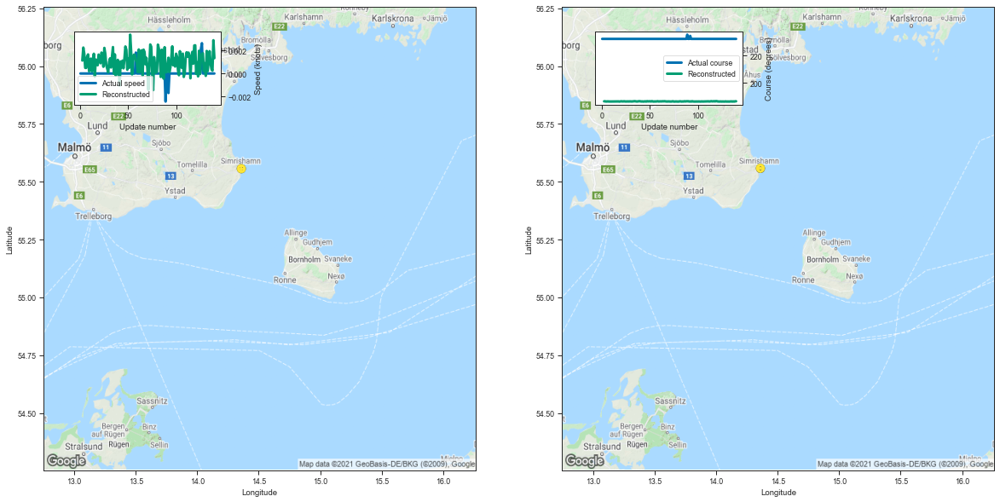

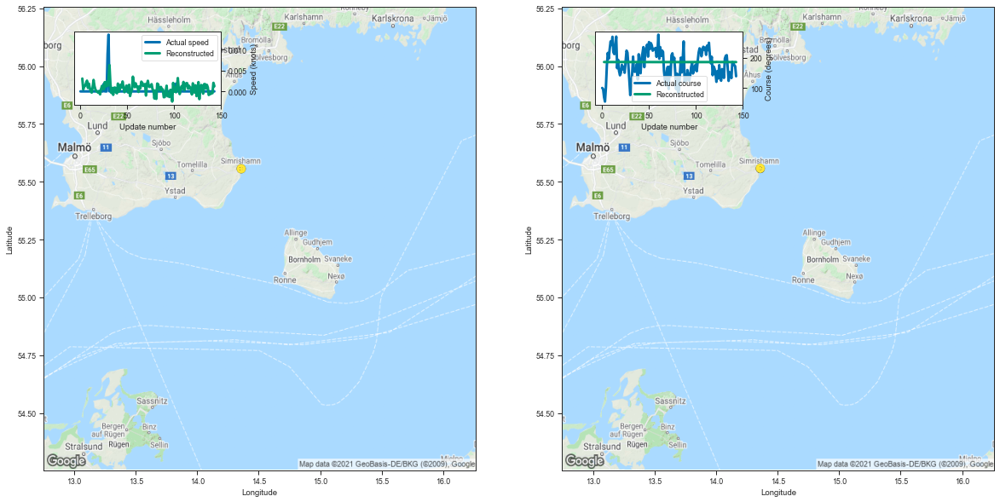

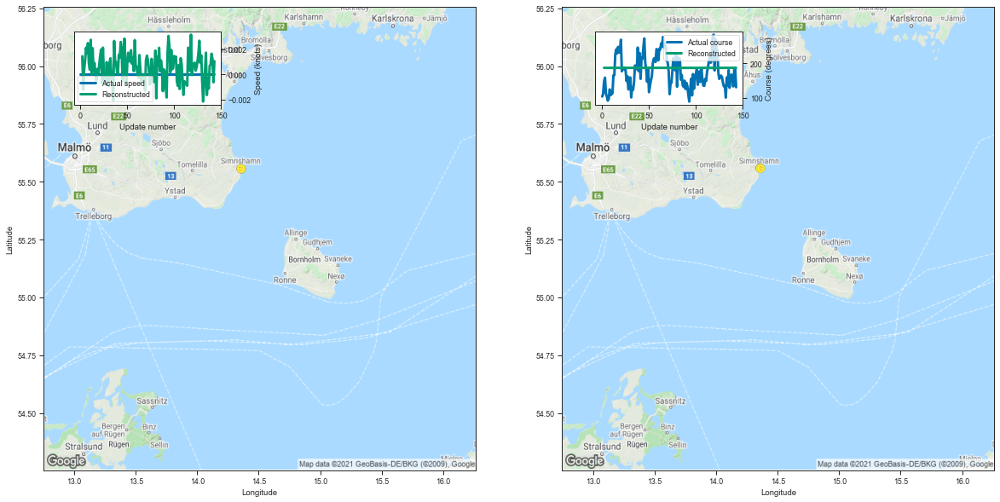

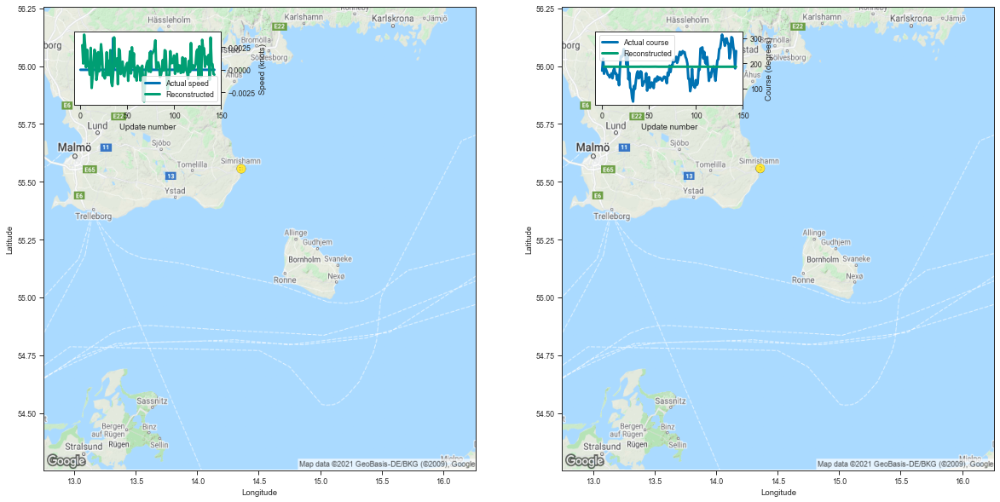

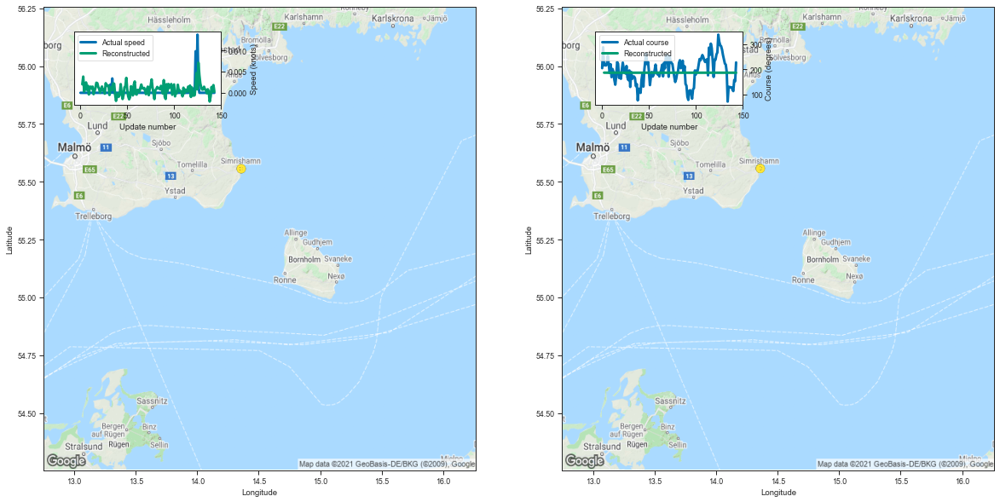

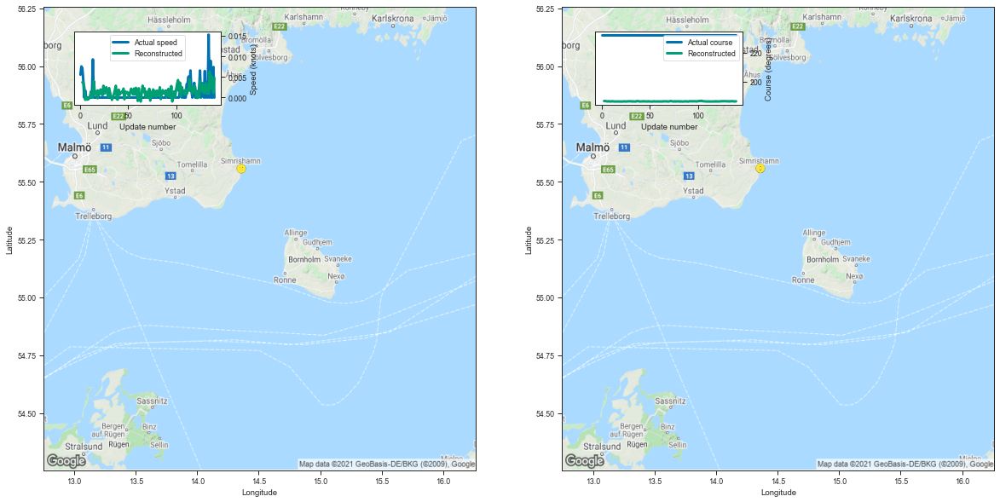

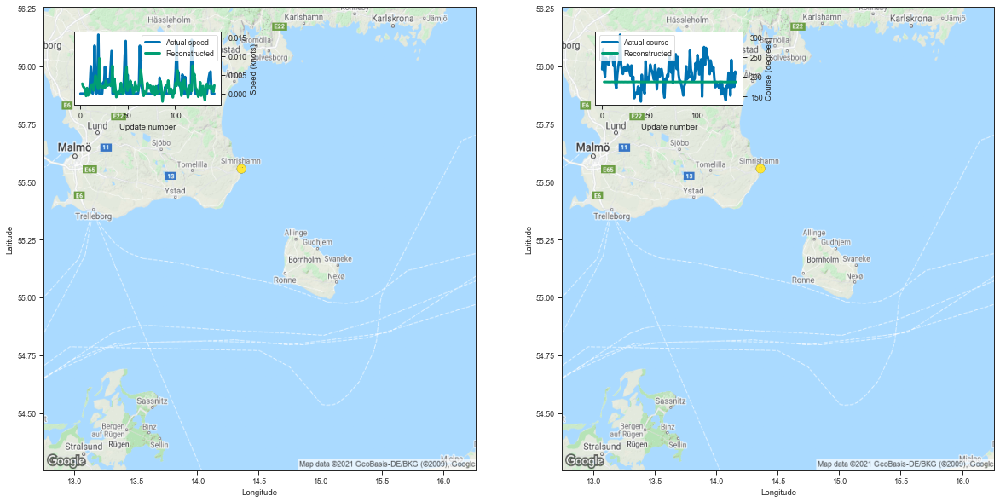

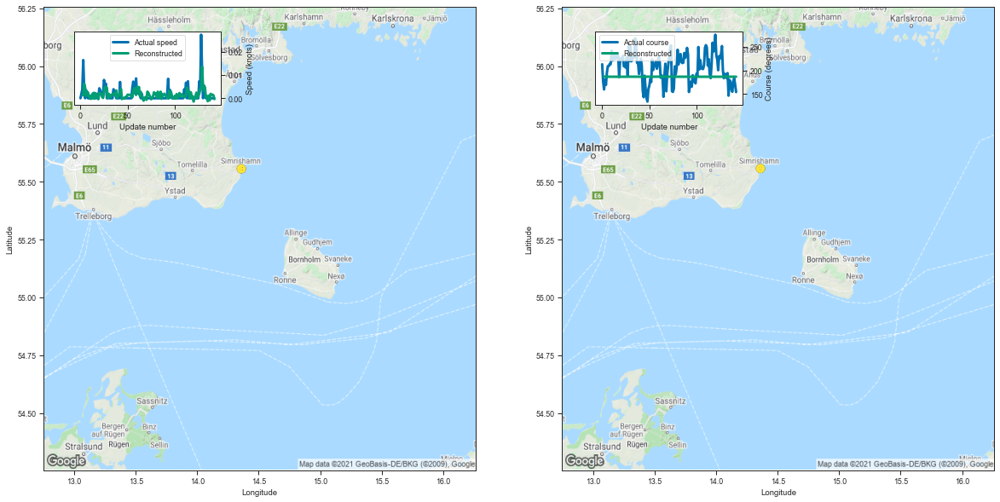

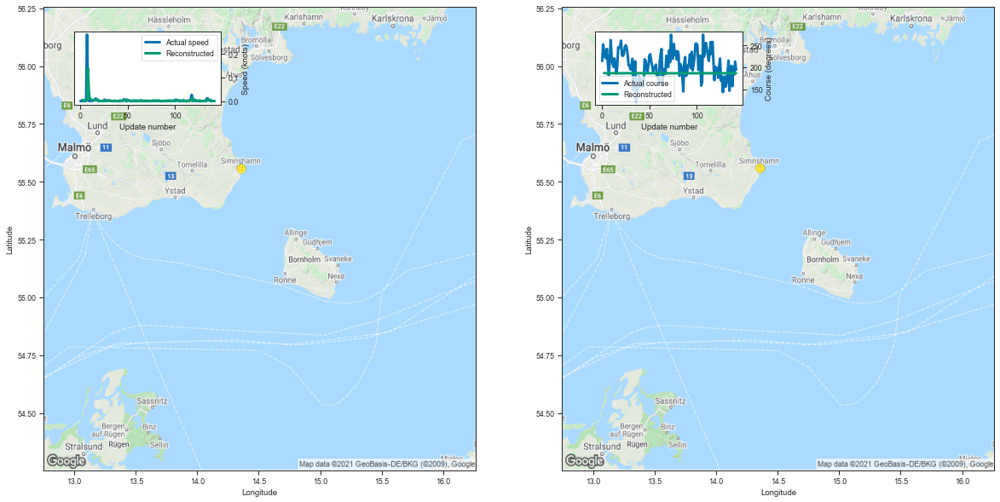

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
57,57,7274400,266054000,Fishing,144,1345.941406,9.346815
106,106,6344170,265755000,Fishing,141,1312.003906,9.304992
26,26,7367080,266054000,Fishing,144,1337.817139,9.290397
43,43,7255864,266054000,Fishing,144,1337.816040,9.290389
39,39,7144648,266054000,Fishing,144,1334.768677,9.269227
1,1,7209524,266054000,Fishing,144,1330.626831,9.240464
94,94,6371407,265755000,Fishing,141,1302.087646,9.234664
46,46,6768741,265759000,Fishing,143,1298.820068,9.082658
105,105,6916021,265759000,Fishing,143,1297.733521,9.075060
58,58,6759536,265759000,Fishing,143,1284.709961,8.983986


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


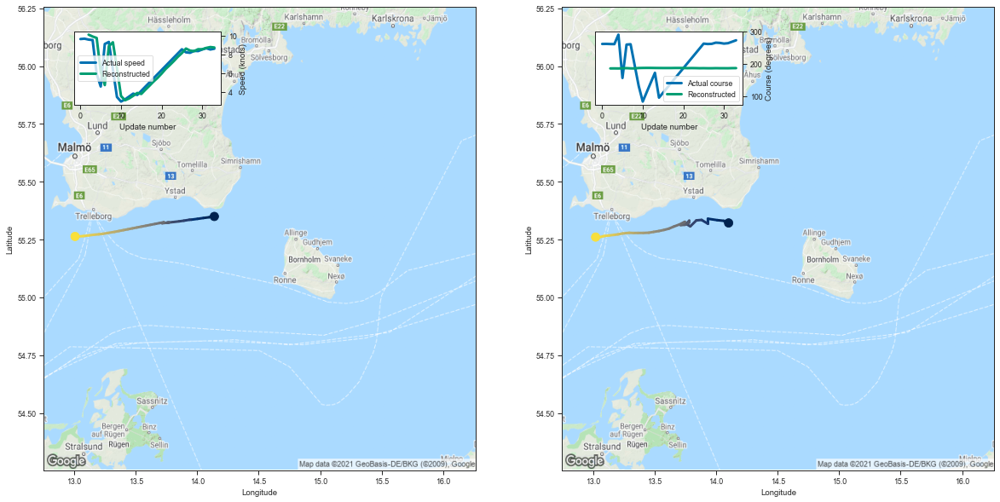

[10.110557556152344, 9.909404754638672, 9.756879806518555, 6.154305934906006]


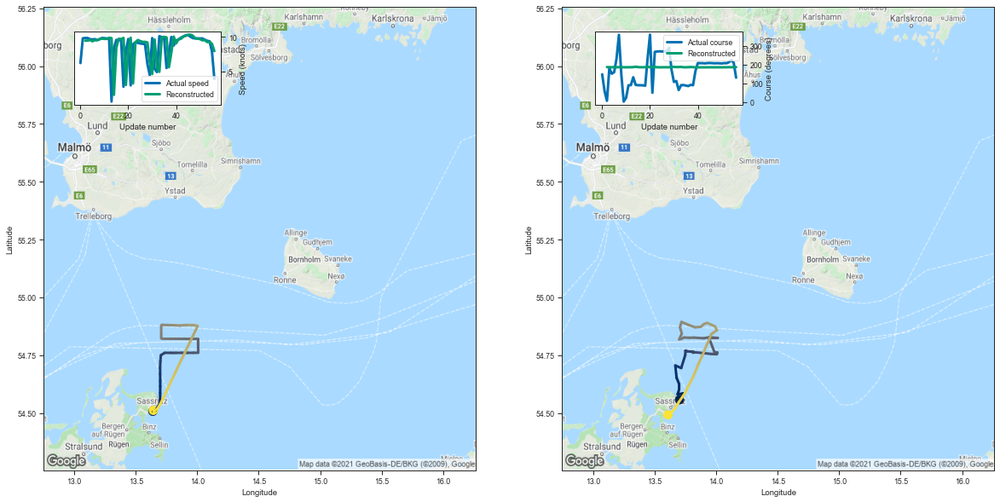

[9.453187942504883, 9.470008850097656, 9.558113098144531, 9.372806549072266]


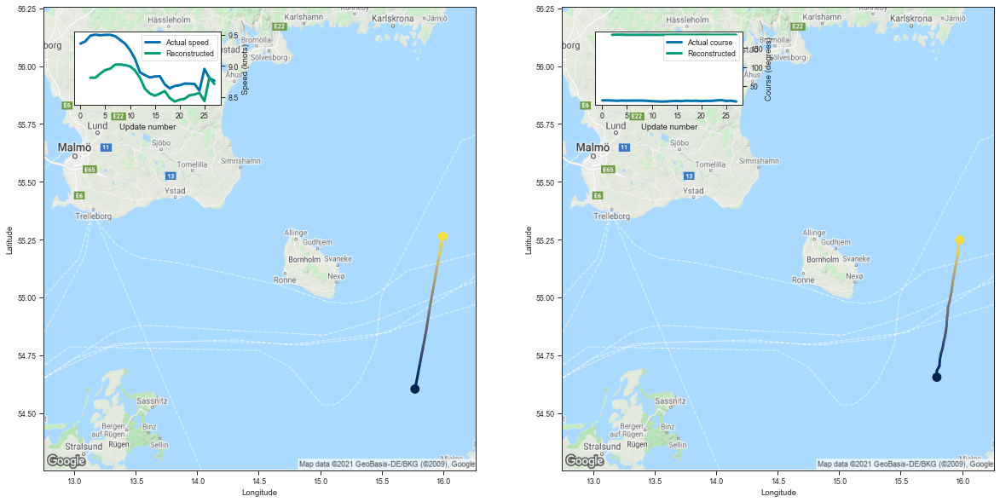

[8.807820320129395, 8.80854606628418, 8.874261856079102, 8.932626724243164]


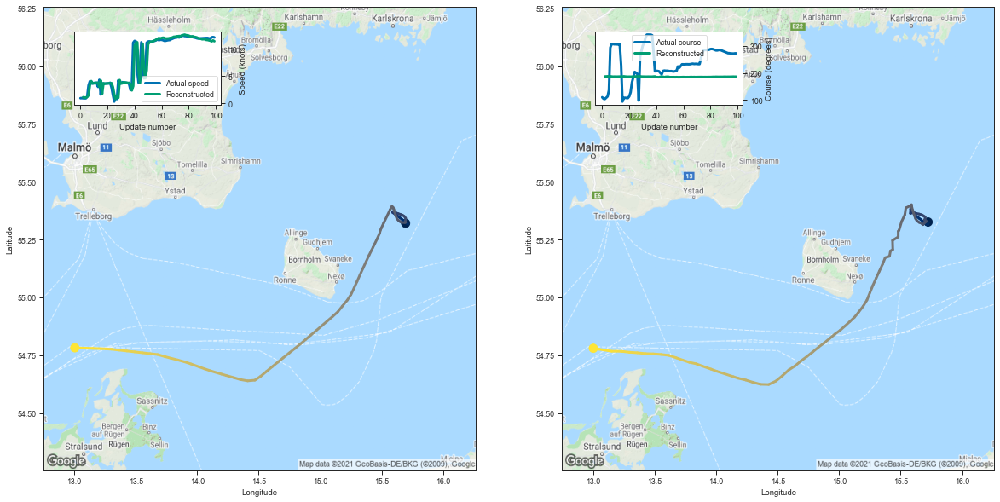

[1.0986249446868896, 1.0489890575408936, 1.0282244682312012, 1.1439311504364014]


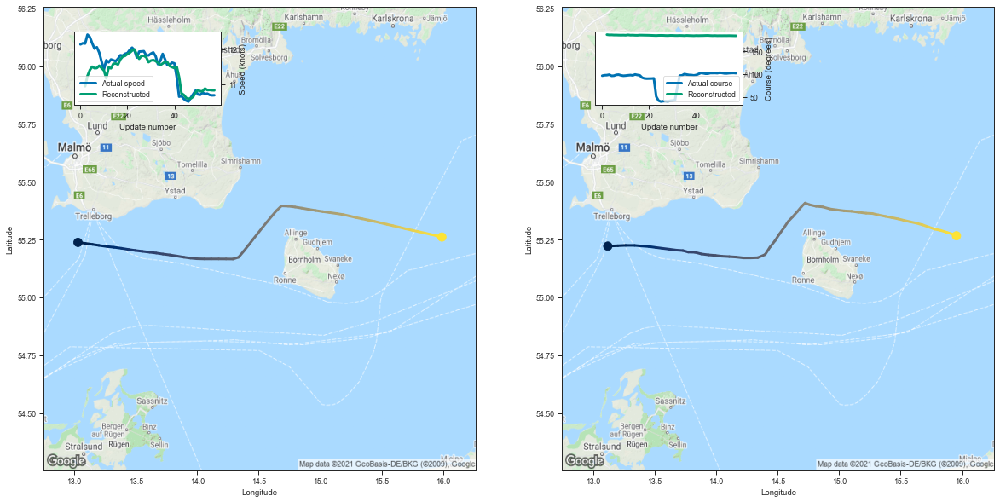

[10.942667007446289, 11.23569107055664, 11.40207290649414, 11.498632431030273]


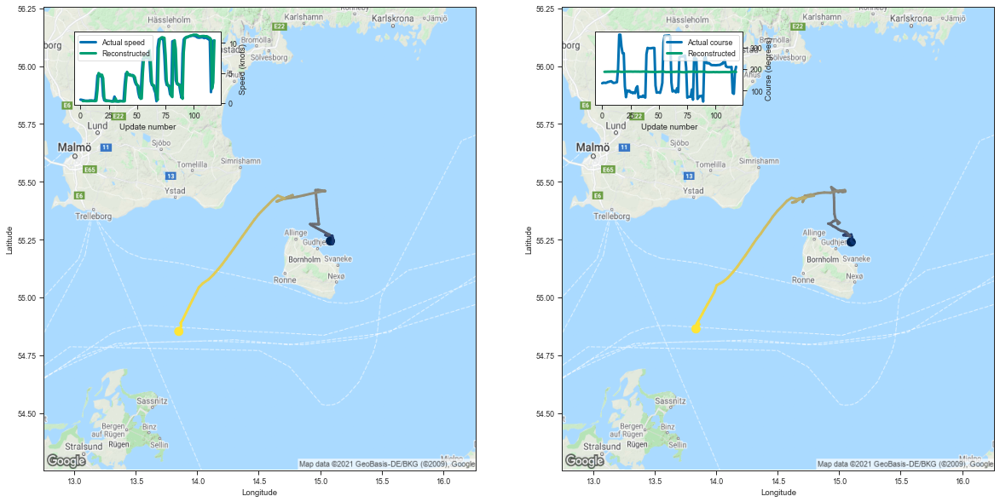

[0.34240734577178955, 0.34516096115112305, 0.35109615325927734, 0.3297988176345825]


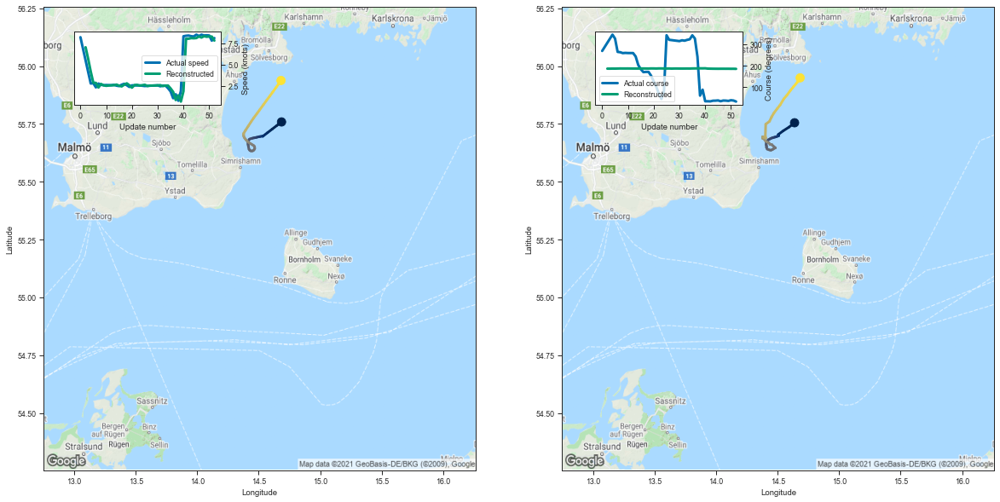

[7.028308391571045, 5.679623126983643, 4.187463760375977, 2.8958425521850586]


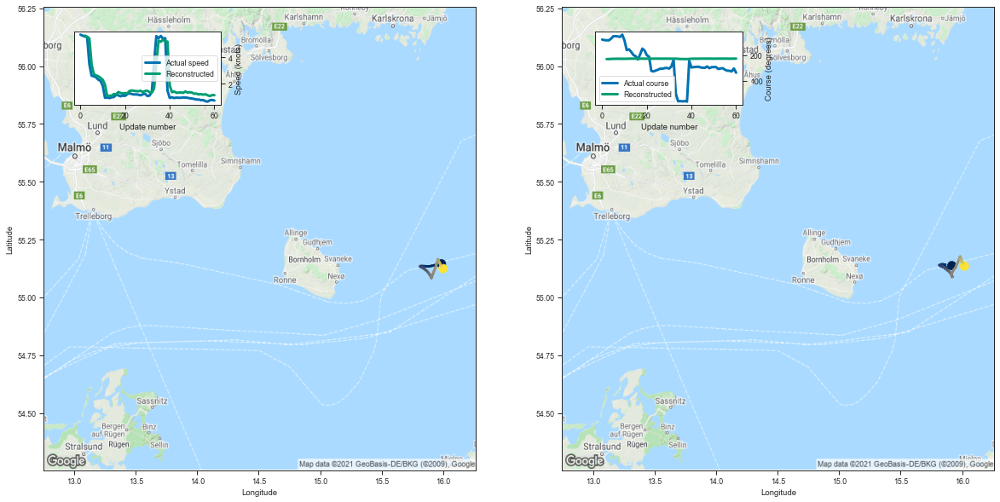

[5.613280296325684, 5.527083396911621, 5.406352996826172, 3.4487252235412598]


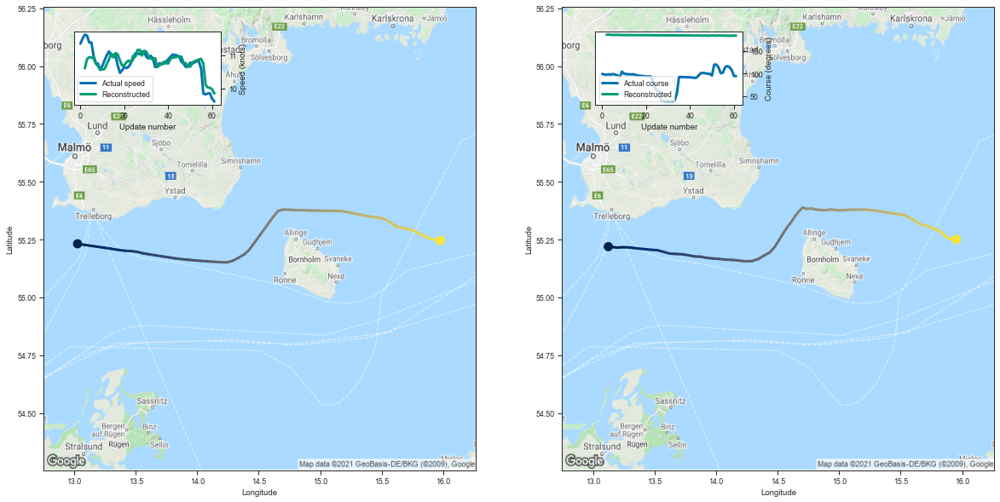

[10.599081039428711, 10.875545501708984, 10.940210342407227, 10.924299240112305]


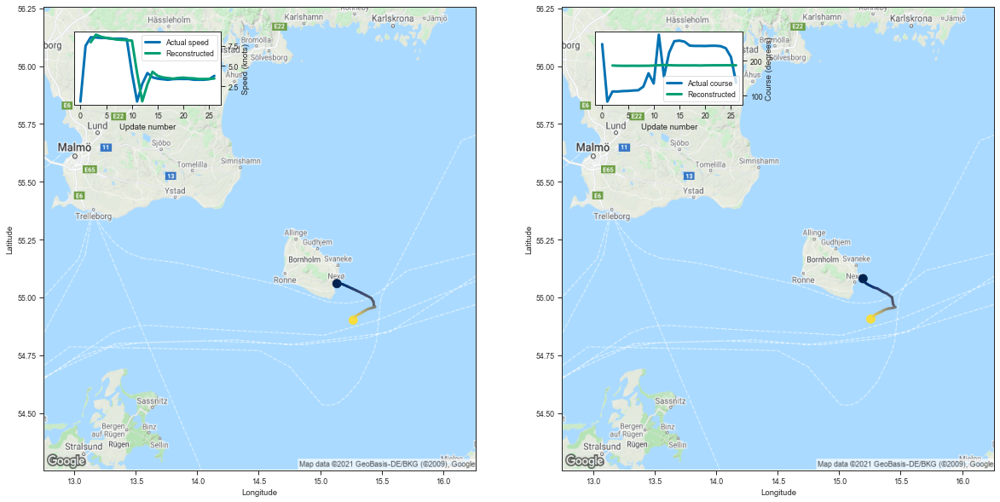

[7.907644748687744, 8.848843574523926, 8.592348098754883, 8.446520805358887]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
100,100,7035686,265759000,Fishing,34,-357.334137,-10.509828
111,111,1126244,211542610,Fishing,57,-170.124893,-2.984647
68,68,4367496,261015270,Fishing,28,-56.546738,-2.019526
90,90,12992,211215500,Fishing,100,-182.061737,-1.820617
64,64,8006943,273537800,Fishing,58,-101.212509,-1.745043
95,95,518910,211417590,Fishing,119,-174.117493,-1.463172
55,55,4970105,265593190,Fishing,53,-67.548012,-1.274491
33,33,4543287,261061000,Fishing,61,-77.336372,-1.267809
59,59,8015021,273538800,Fishing,62,-73.557823,-1.186417
5,5,460005,211317720,Fishing,27,-21.174049,-0.784224


In [11]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


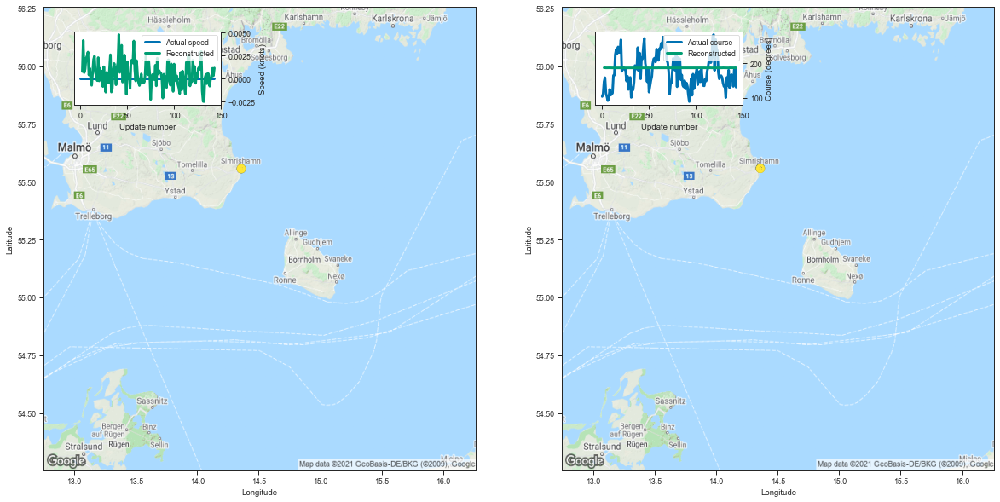

[0.0007748603820800781, 0.004162311553955078, 0.0006585121154785156, 0.001056671142578125]


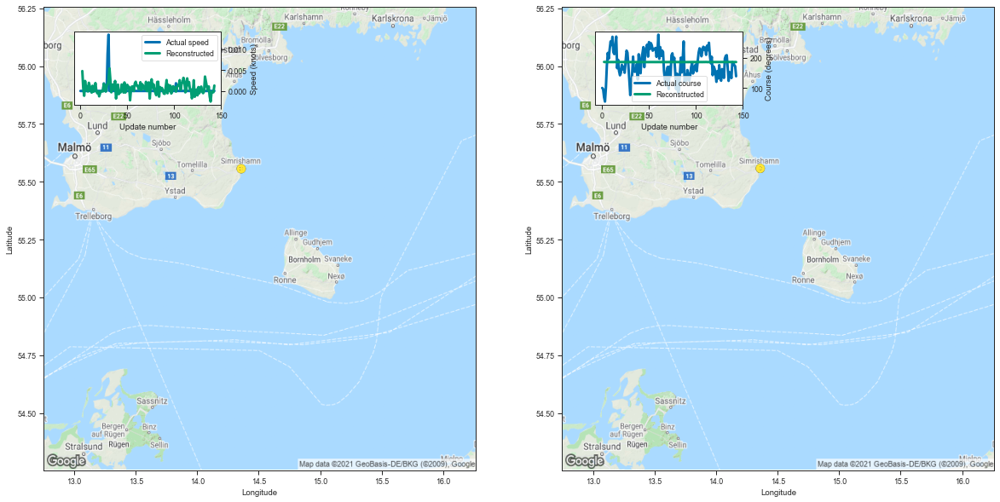

[0.004788398742675781, 0.0006723403930664062, -0.0011591911315917969, 0.0024025440216064453]


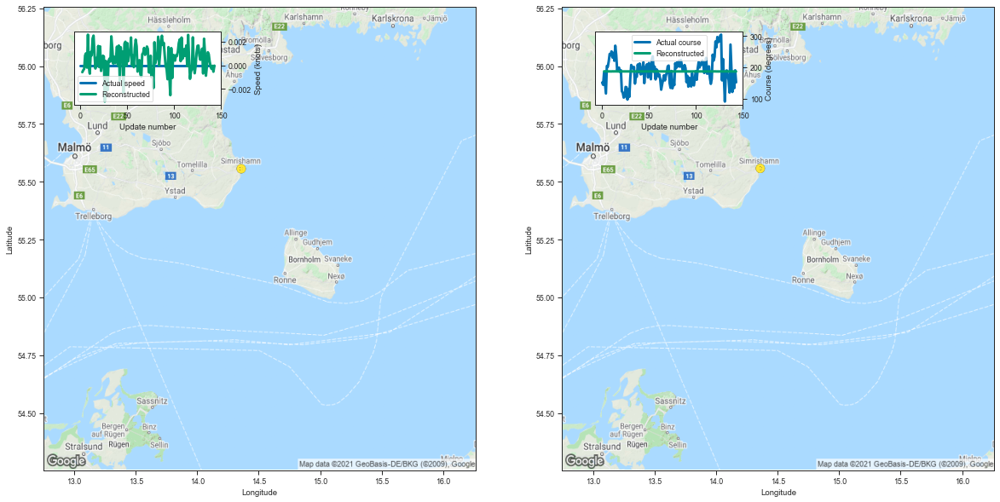

[-0.00058746337890625, -0.0004177093505859375, -0.00031185150146484375, 0.0008378028869628906]


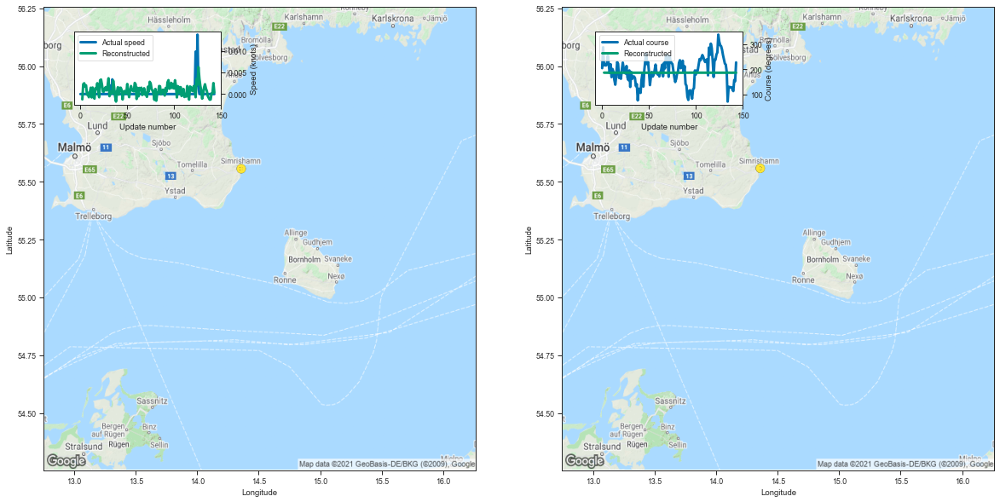

[-0.0012276172637939453, 0.0022859573364257812, 0.0024950504302978516, 0.0017342567443847656]


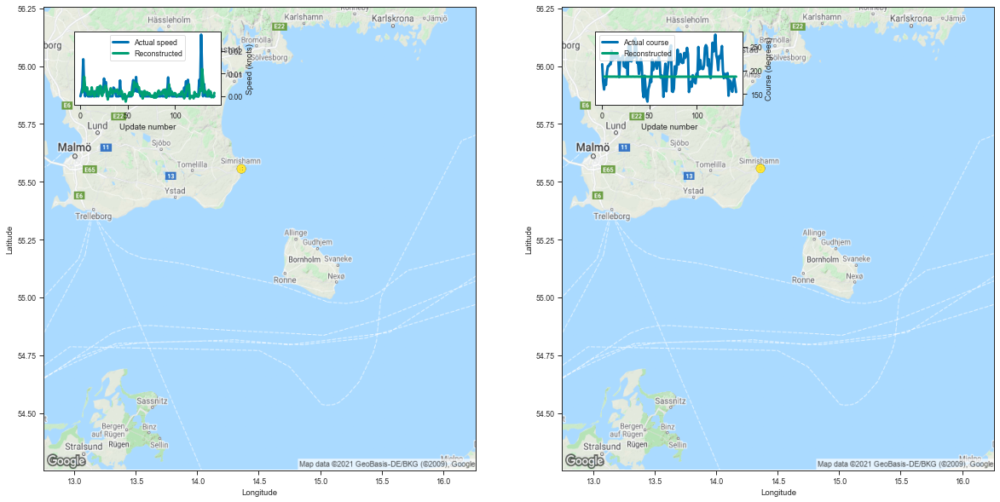

[0.0017447471618652344, 0.0035829544067382812, 0.008657693862915039, 0.0033953189849853516]


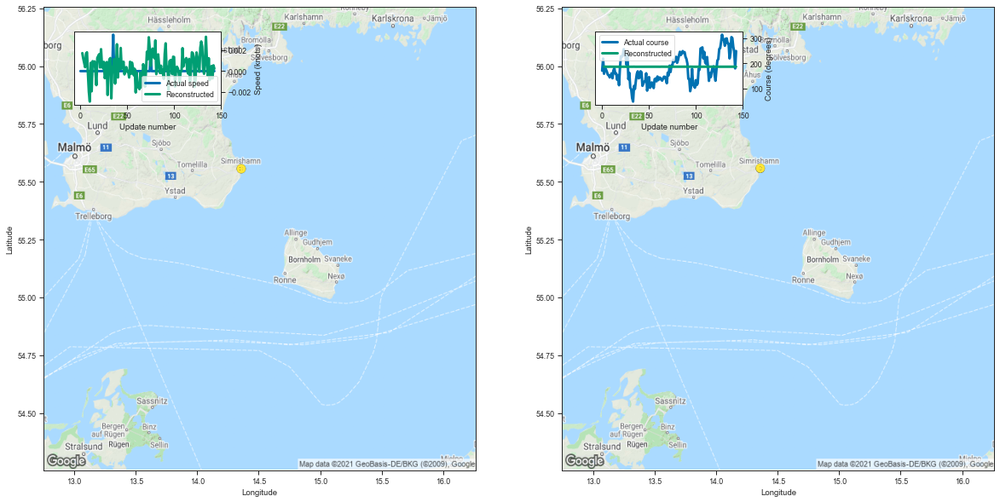

[0.0017299652099609375, 0.0012211799621582031, 0.0008153915405273438, 0.0003790855407714844]


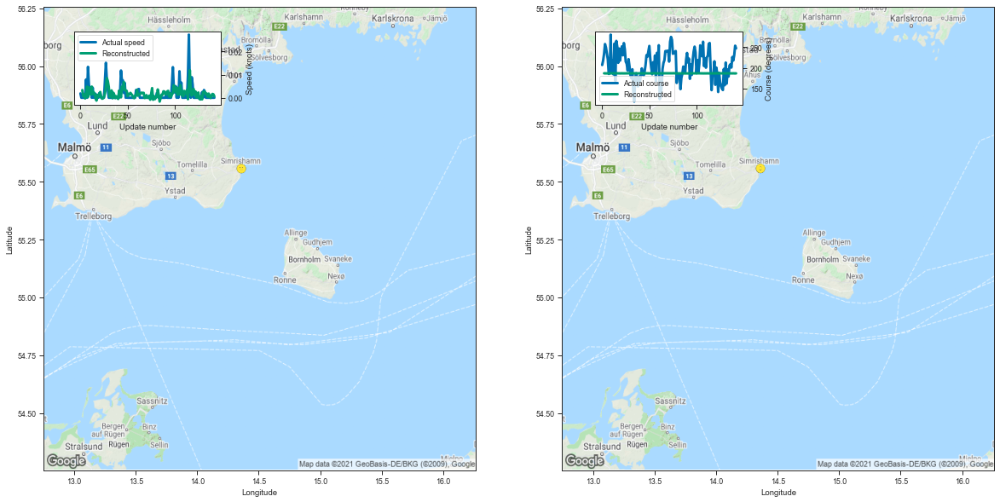

[0.0033054351806640625, 0.0006268024444580078, 0.0016117095947265625, -0.0002951622009277344]


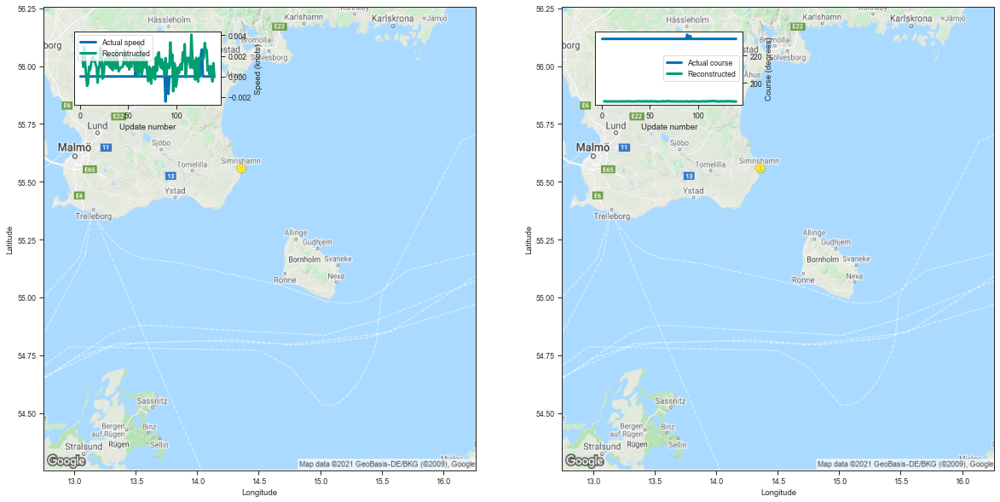

[0.001983642578125, 0.0009403228759765625, 0.0028595924377441406, 0.001132965087890625]


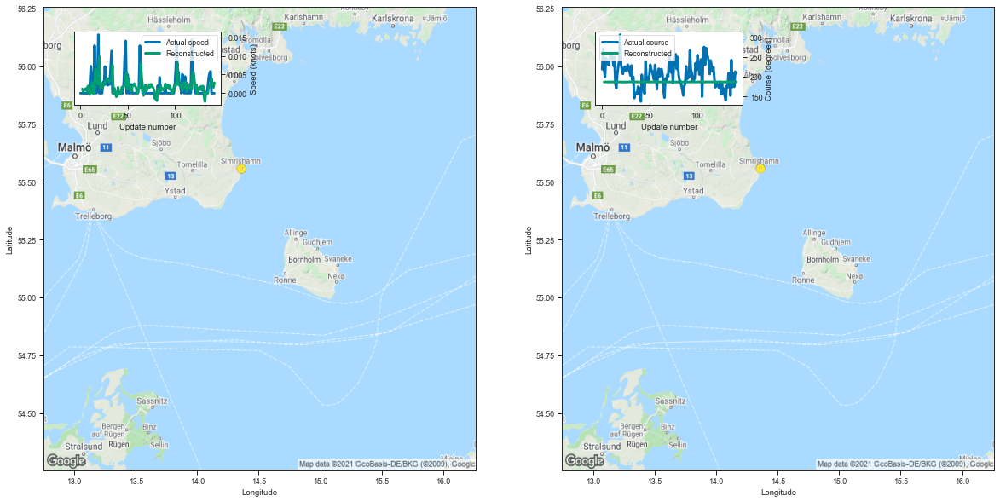

[0.0011463165283203125, 0.0004334449768066406, 0.0009889602661132812, 0.0010061264038085938]


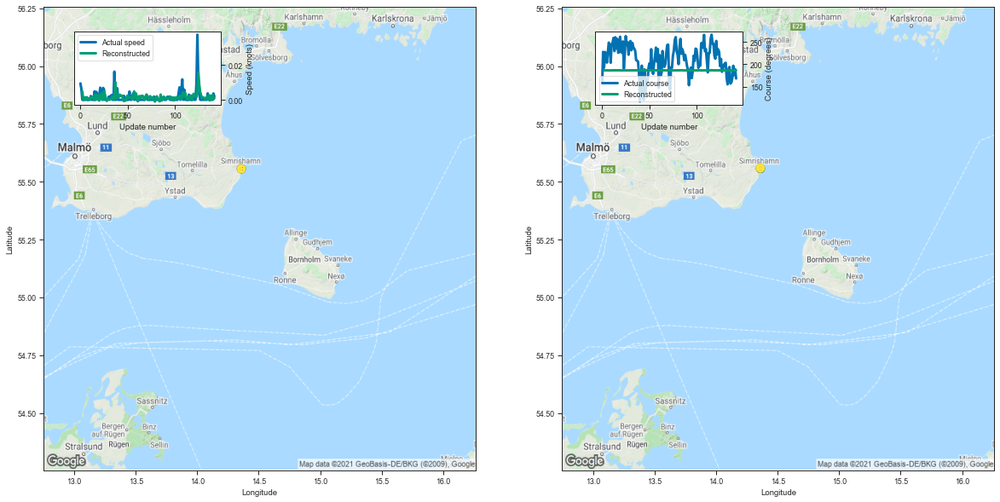

[0.004764556884765625, -0.00010347366333007812, 0.0006518363952636719, 0.0014410018920898438]


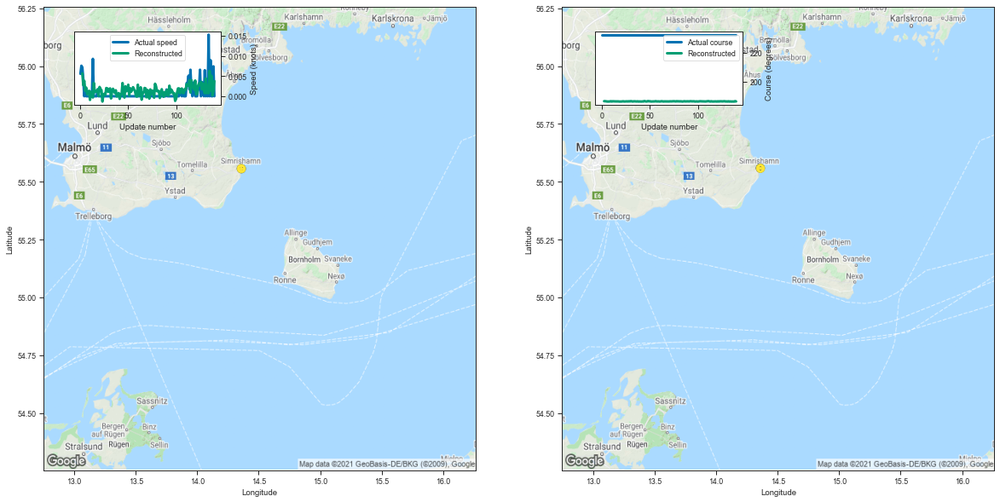

[0.005659341812133789, 0.0027201175689697266, 0.0038199424743652344, 0.0013532638549804688]


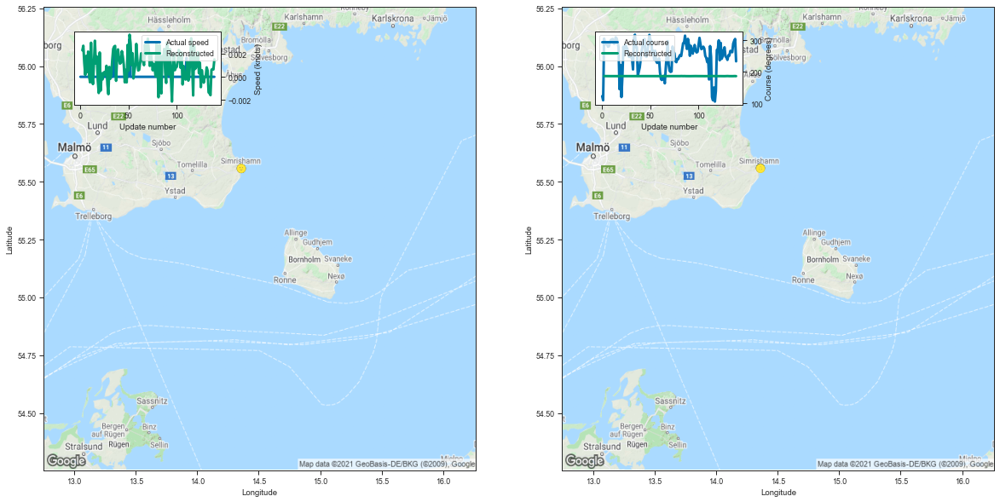

[0.0023059844970703125, 0.002700328826904297, 0.0012040138244628906, 0.00017023086547851562]


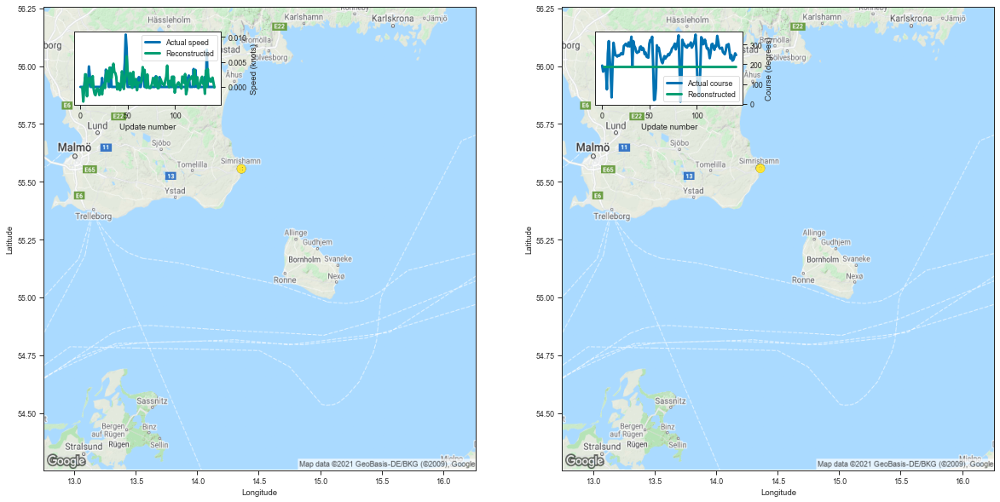

[-9.226799011230469e-05, -0.0029163360595703125, -0.0006372928619384766, 0.0025207996368408203]


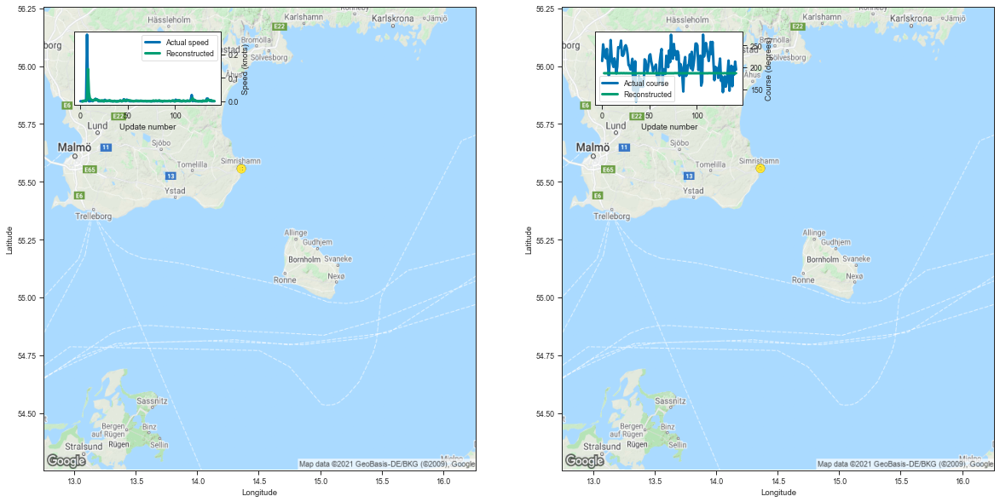

[-0.0015501976013183594, 0.002063751220703125, 0.0016317367553710938, 0.001416921615600586]


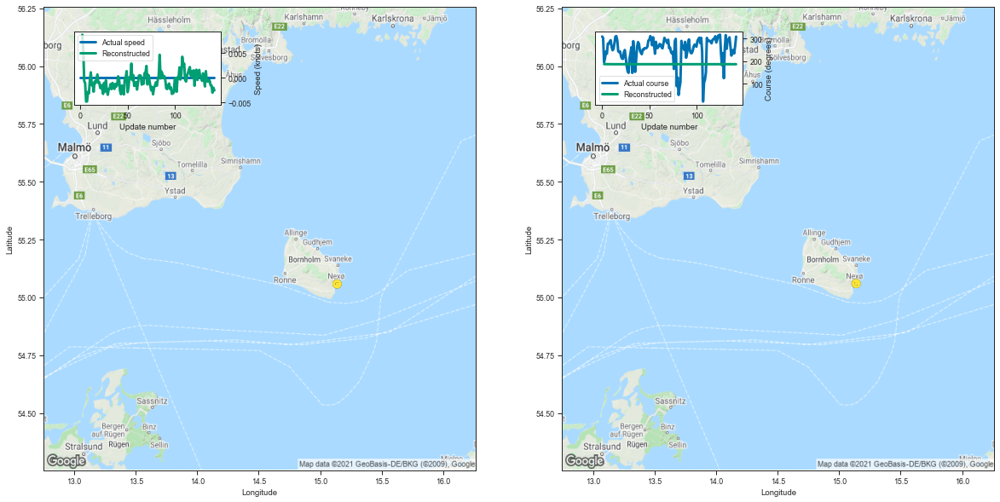

[0.008786678314208984, 0.005776405334472656, -0.00063323974609375, -0.0010876655578613281]


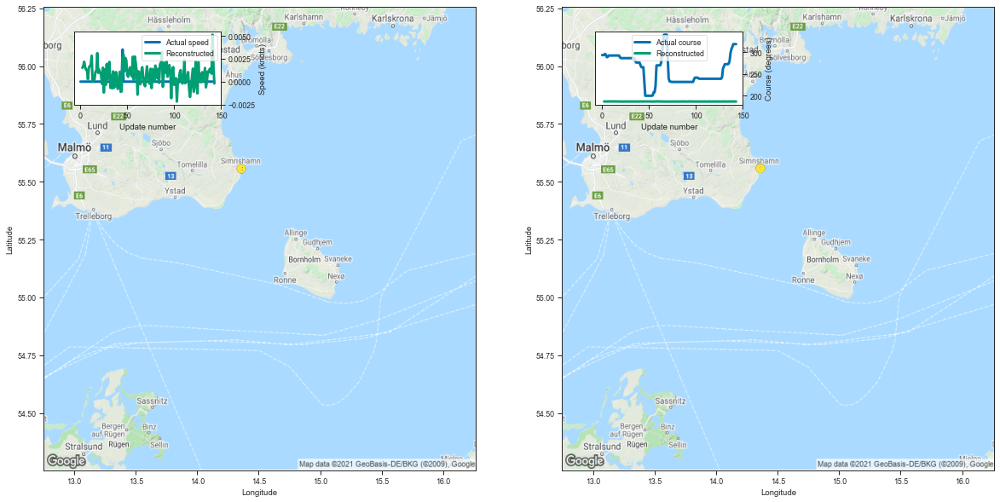

[0.0015075206756591797, 0.0017023086547851562, 0.002167940139770508, 0.0015959739685058594]


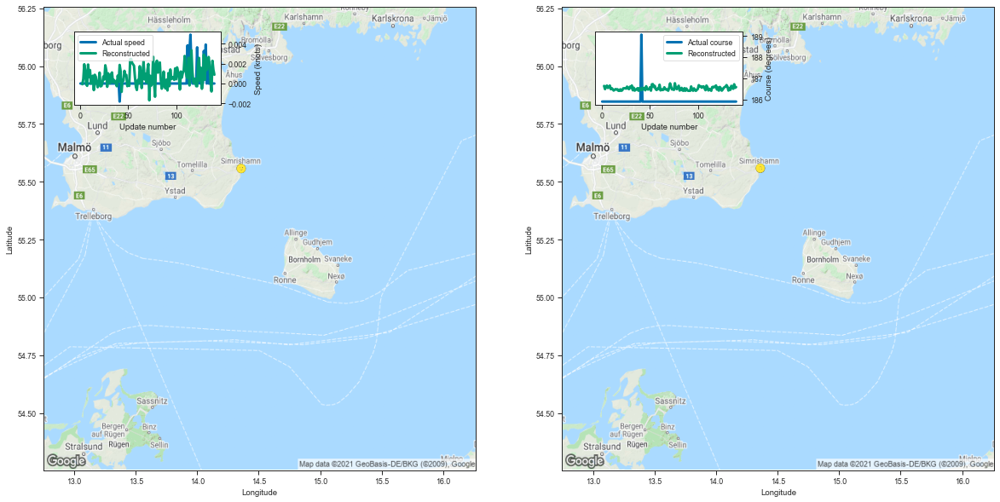

[-7.486343383789062e-05, 0.0004596710205078125, 0.0019333362579345703, 0.0013875961303710938]


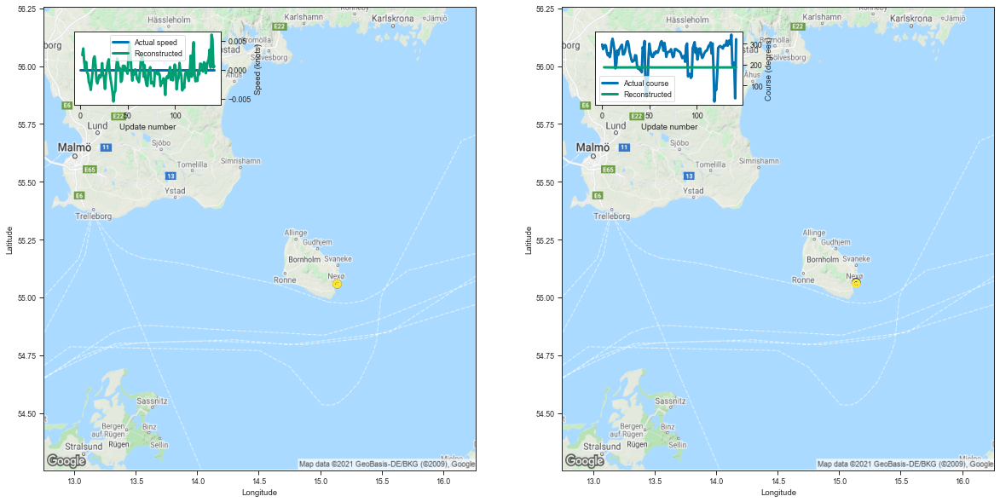

[0.002541065216064453, 0.003671407699584961, 0.0014009475708007812, 0.0002117156982421875]


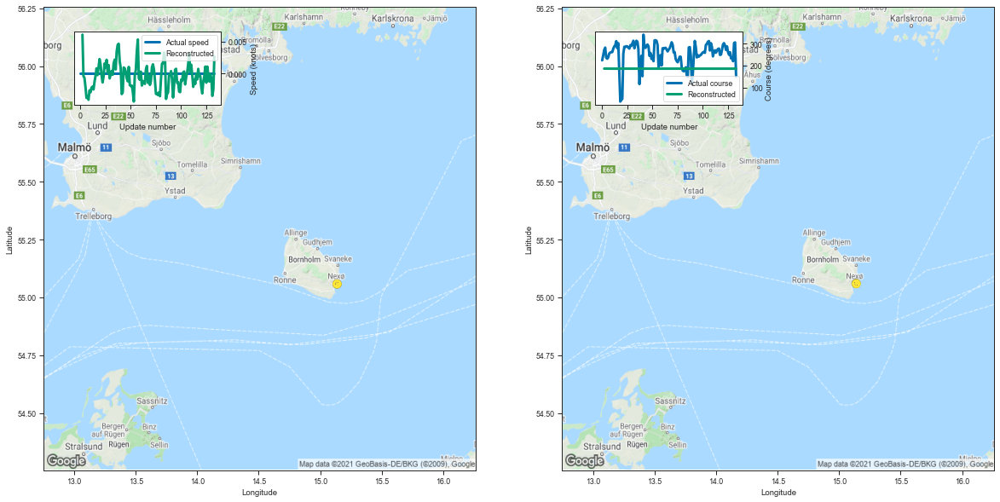

[0.006069660186767578, -0.0003745555877685547, -0.0006554126739501953, -0.0020487308502197266]


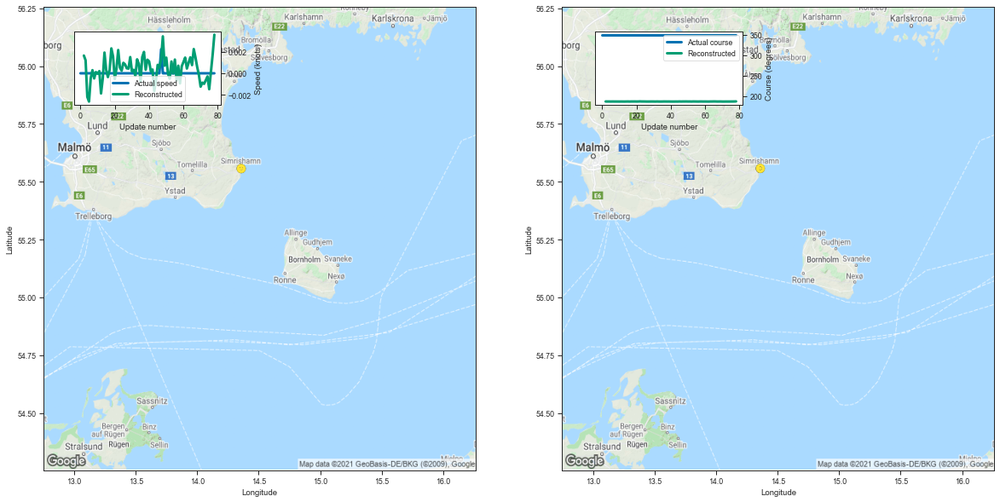

[0.0016374588012695312, 0.0012001991271972656, -0.002178192138671875, -0.0026085376739501953]


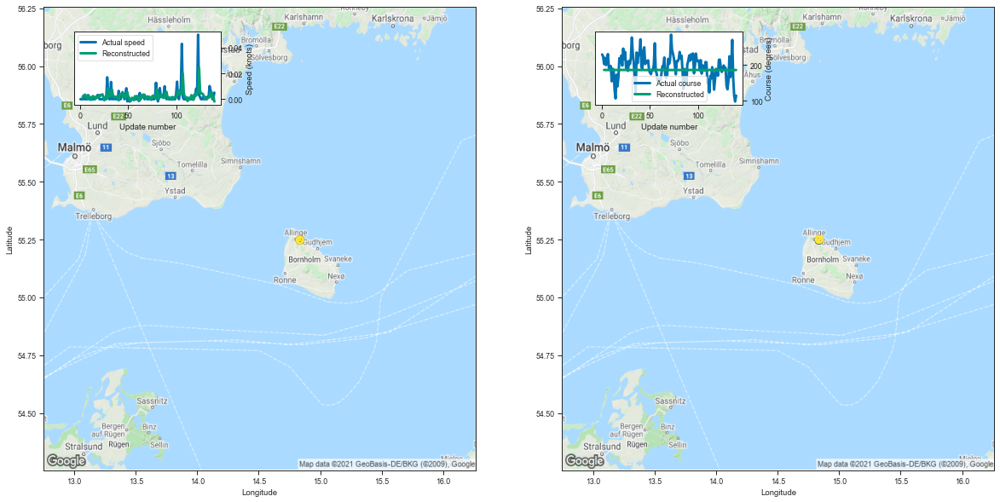

[0.0006427764892578125, 0.002728700637817383, 0.003125429153442383, 0.003539562225341797]


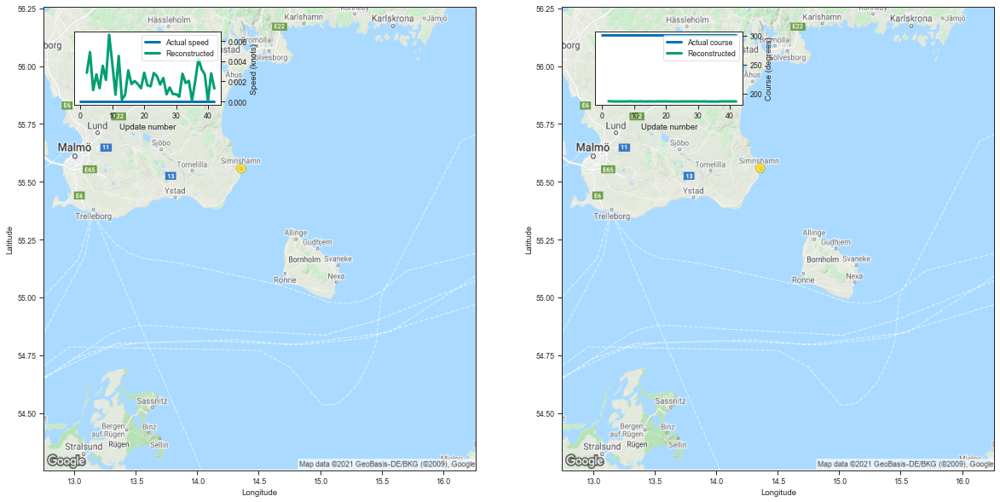

[0.0028498172760009766, 0.00490570068359375, 0.0011382102966308594, 0.002691030502319336]


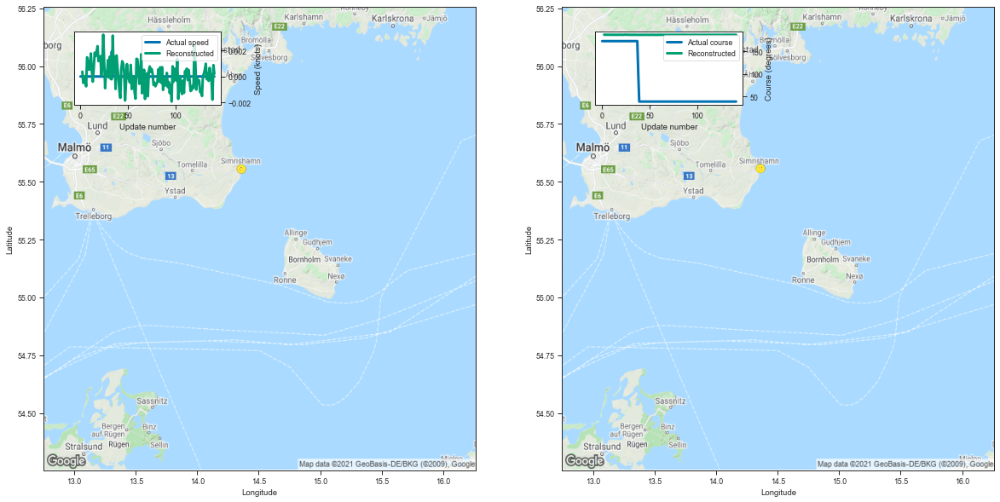

[0.00037217140197753906, -0.0004968643188476562, -2.86102294921875e-06, -0.00010442733764648438]


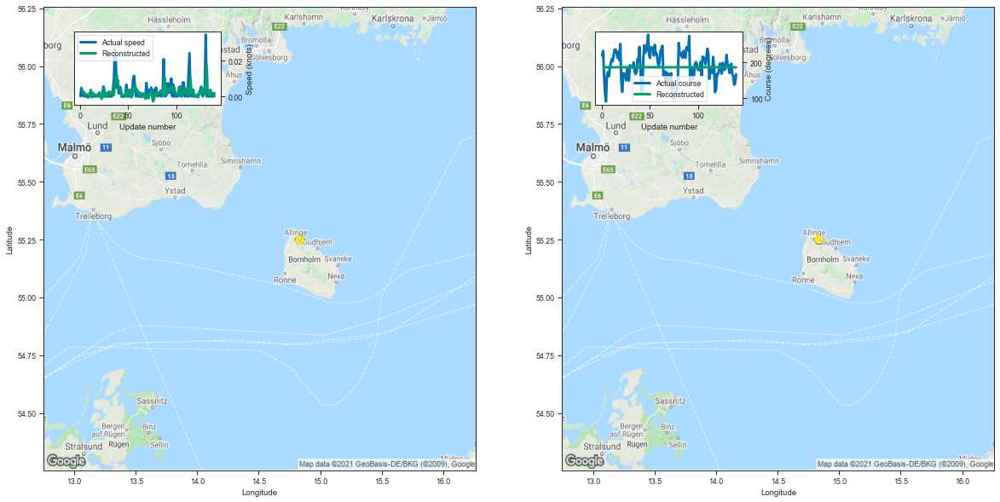

[0.0034036636352539062, 0.0017819404602050781, 0.002323627471923828, 0.0006504058837890625]


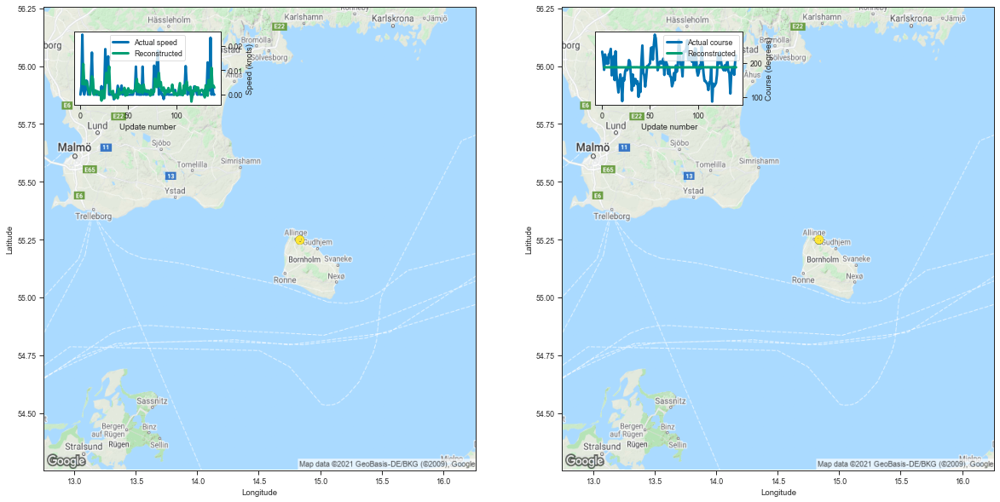

[0.004337787628173828, 0.012595295906066895, 0.004221439361572266, 0.004153728485107422]


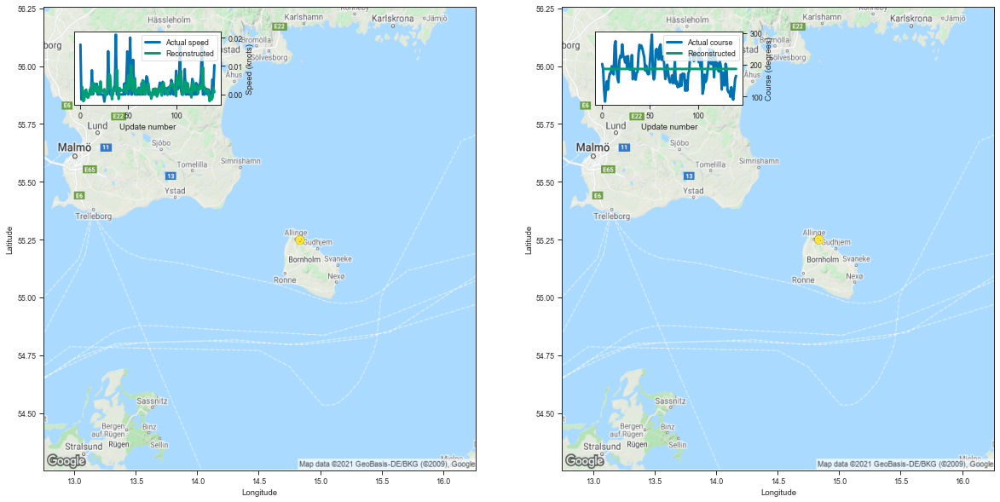

[0.0026154518127441406, -0.00237274169921875, -0.0019736289978027344, 0.0013420581817626953]


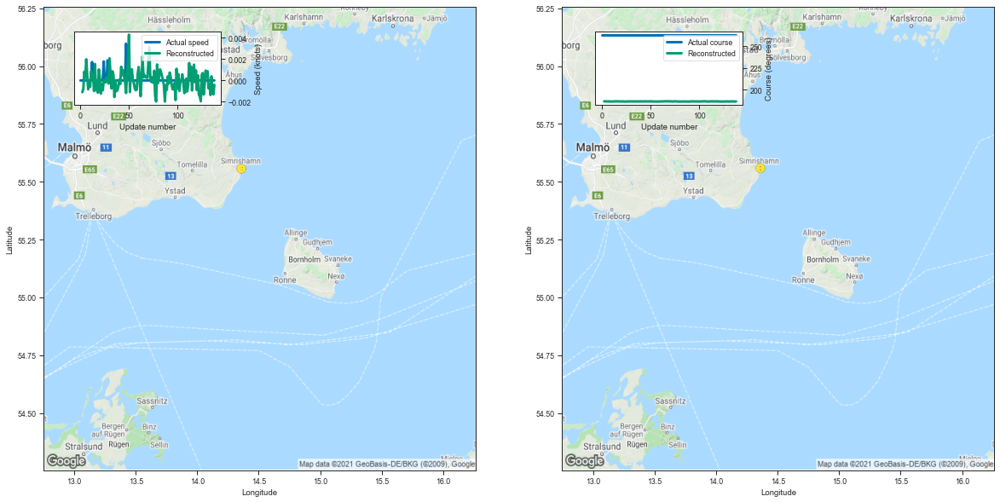

[-0.0011067390441894531, -0.0007734298706054688, 0.0008213520050048828, 0.00026702880859375]


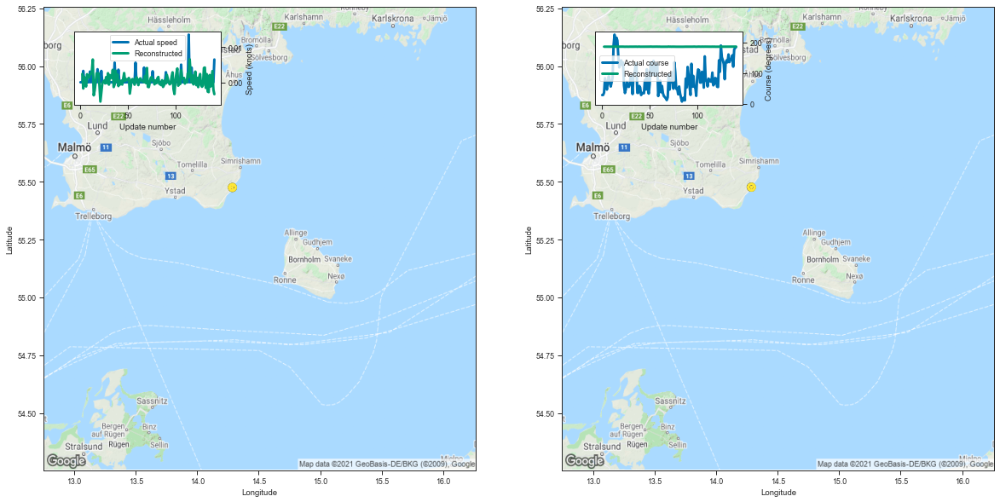

[0.0023674964904785156, -0.0017757415771484375, 0.0015370845794677734, -0.0005192756652832031]


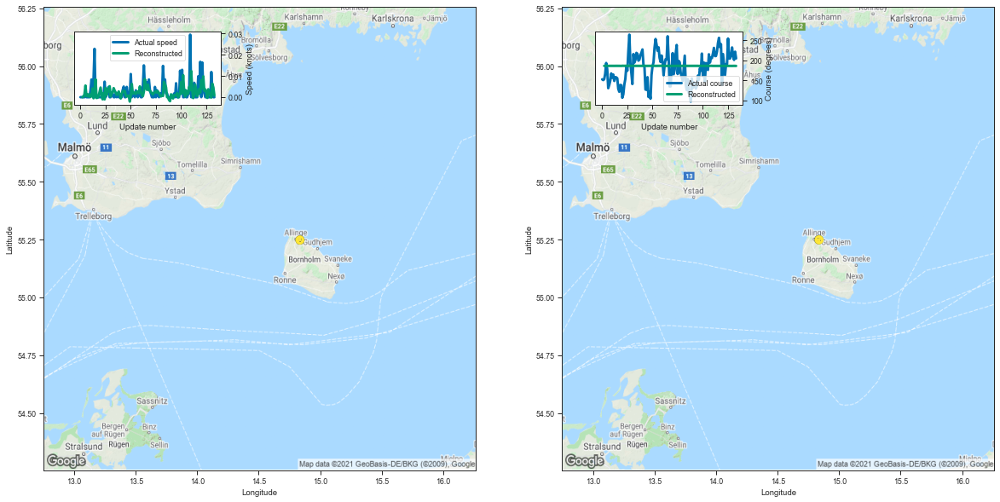

[1.1920928955078125e-05, 0.00031566619873046875, 0.0012764930725097656, 0.005476474761962891]


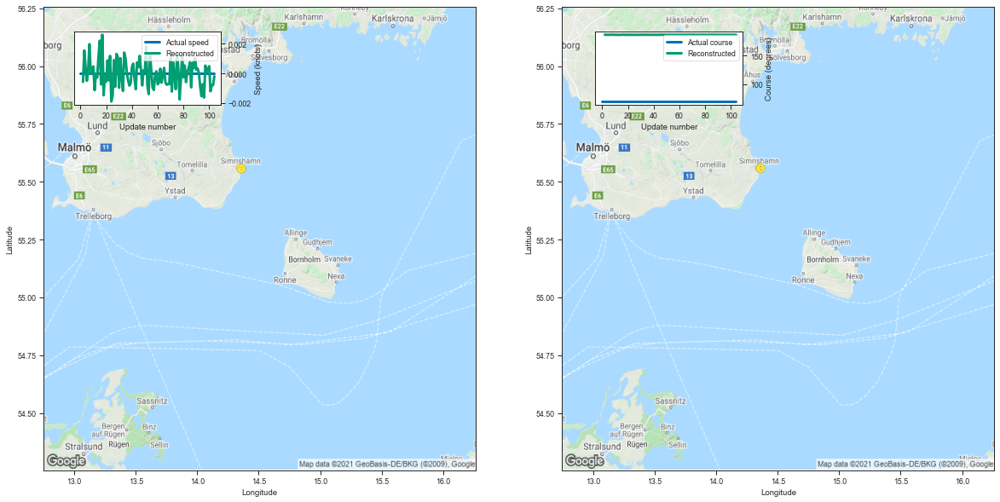

[-0.0005776882171630859, 0.0015568733215332031, 0.0003535747528076172, -0.0005037784576416016]


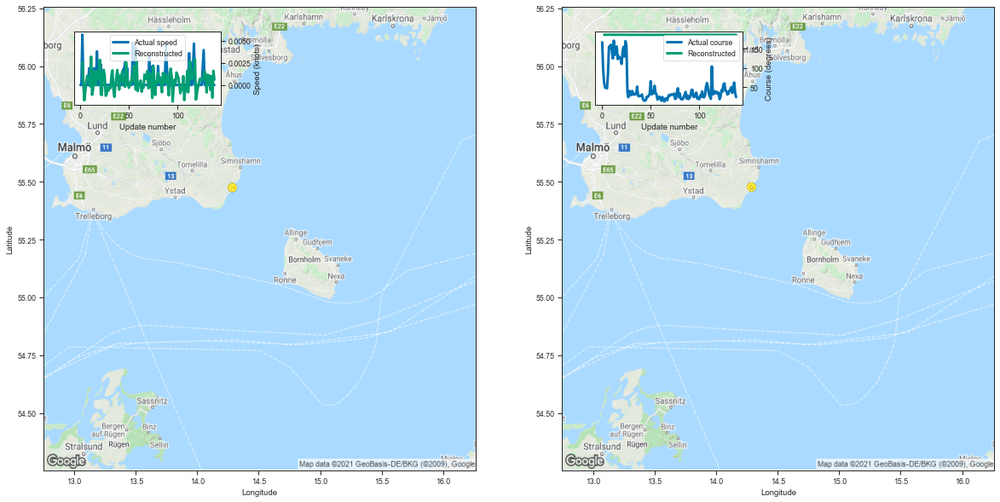

[0.0025434494018554688, 0.0001983642578125, -0.0017240047454833984, -0.0007729530334472656]


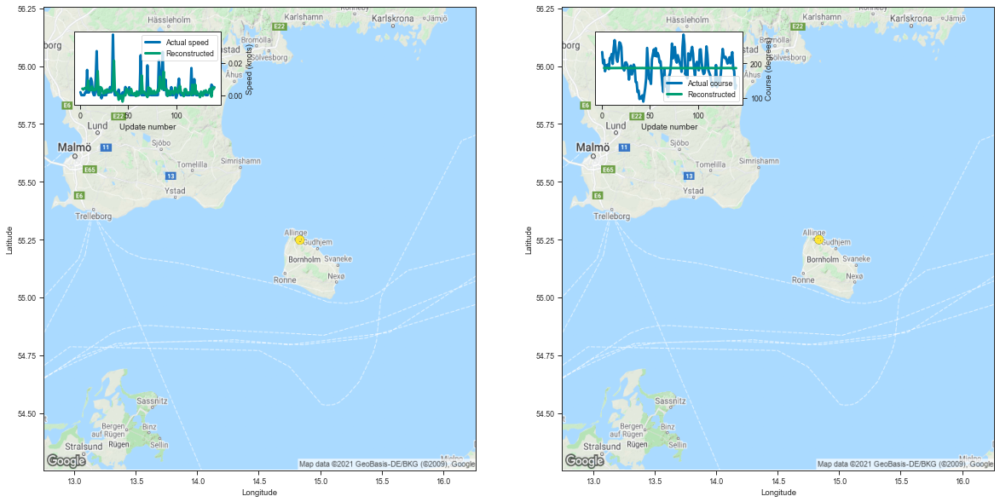

[0.003986358642578125, 0.003437519073486328, 0.004124641418457031, 0.0042934417724609375]


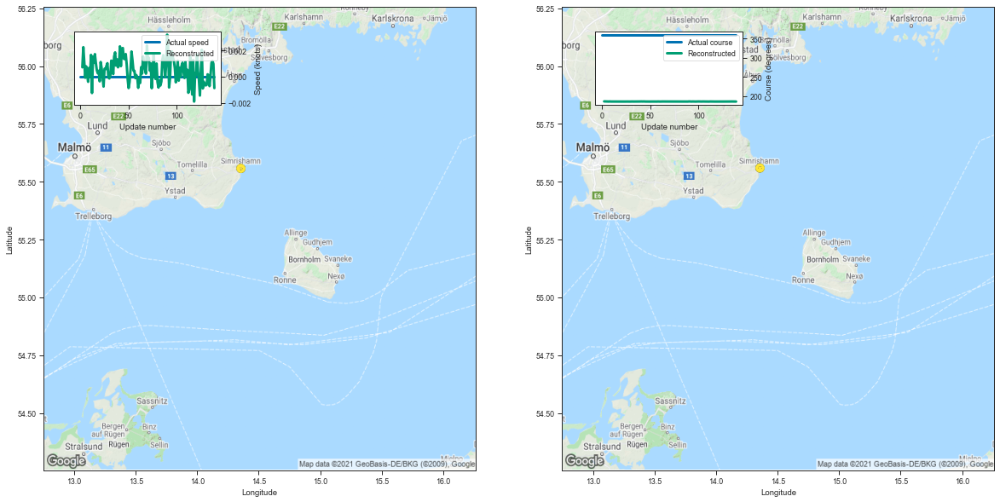

[0.0007112026214599609, 0.0022513866424560547, 0.0011096000671386719, -8.869171142578125e-05]


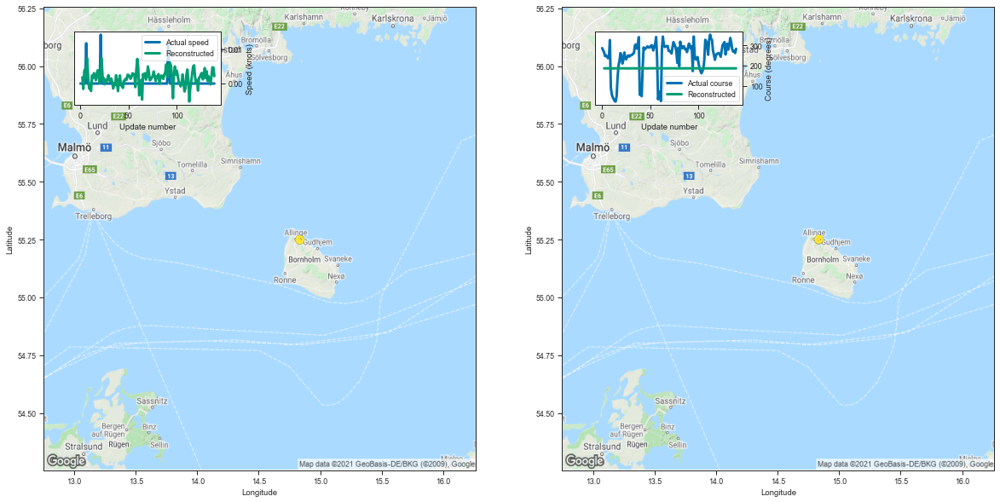

[0.001827239990234375, -0.0015625953674316406, 0.0036497116088867188, 0.0043315887451171875]


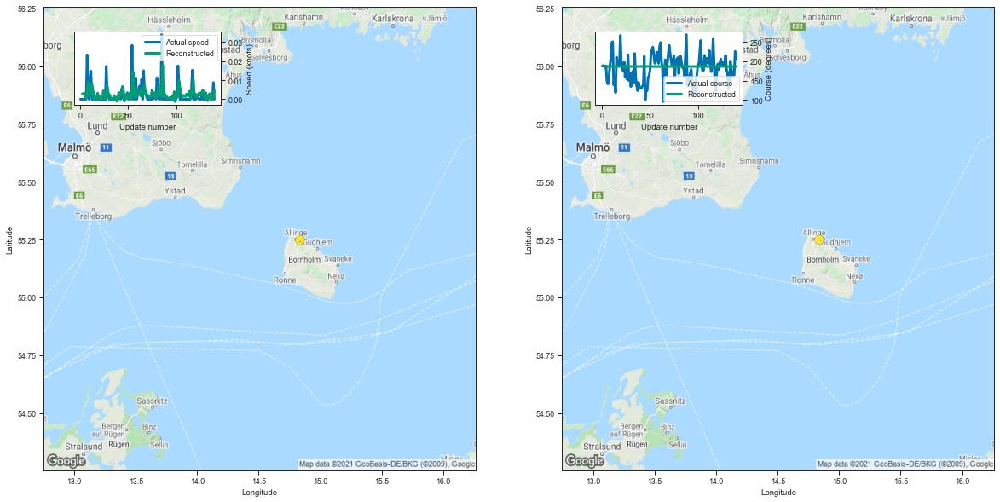

[0.002947092056274414, 0.0026178359985351562, 0.003082275390625, 0.0028467178344726562]


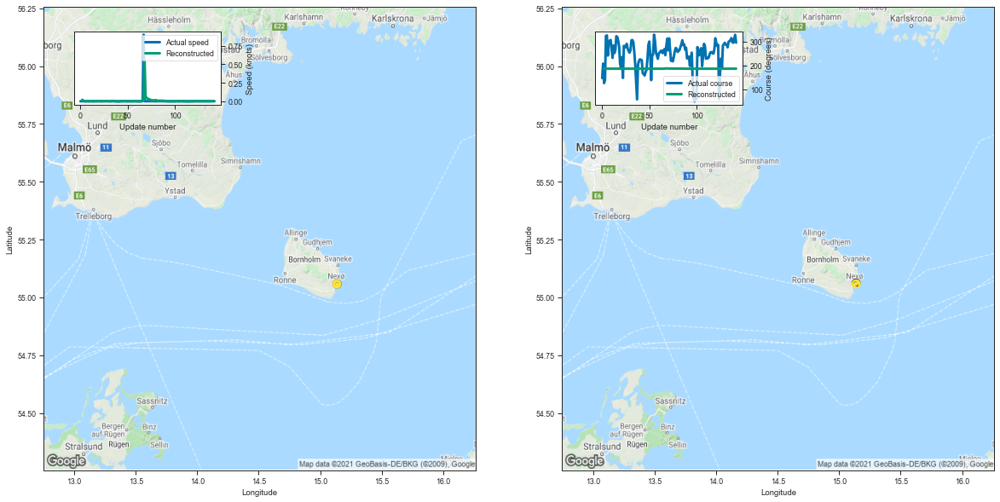

[0.0209043025970459, 0.006144046783447266, -0.0012128353118896484, -0.0006303787231445312]


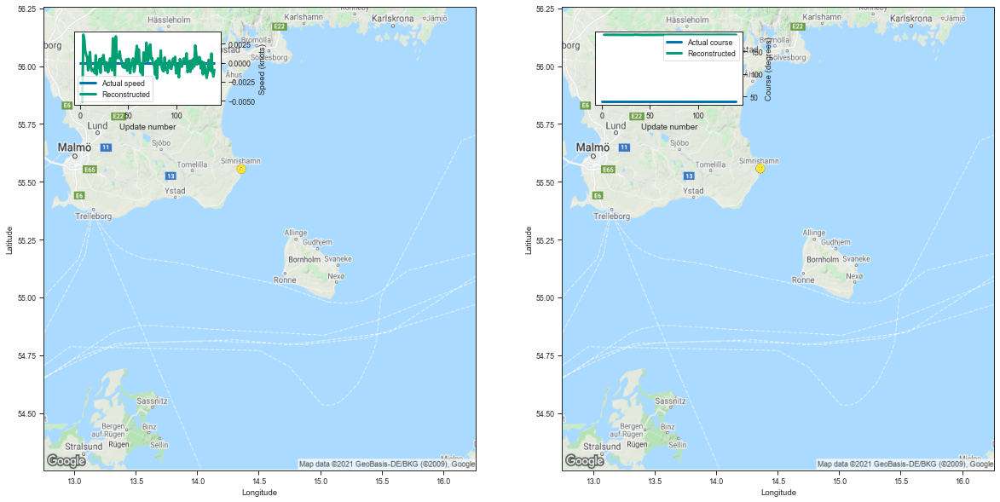

[-0.005088329315185547, 0.0036859512329101562, 0.003110170364379883, 0.0015850067138671875]


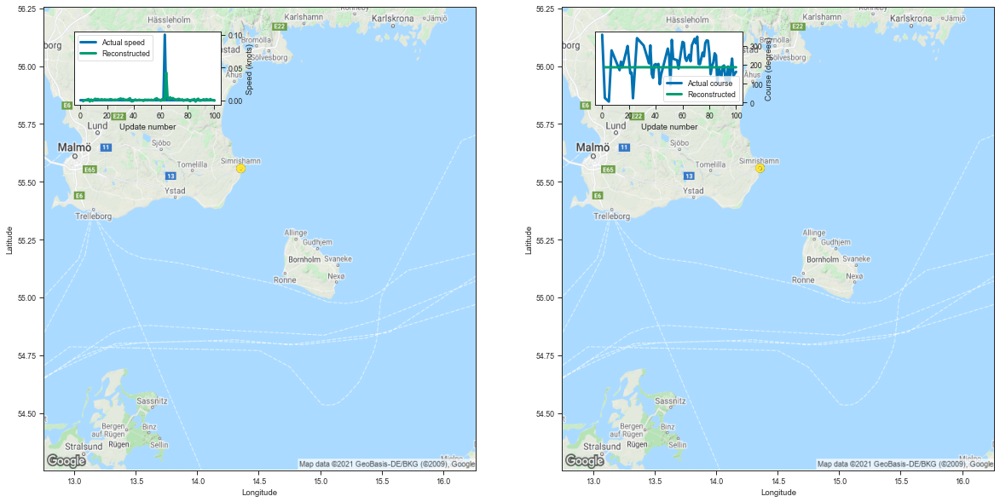

[-0.0015687942504882812, -3.814697265625e-05, 0.00044727325439453125, 0.0007596015930175781]


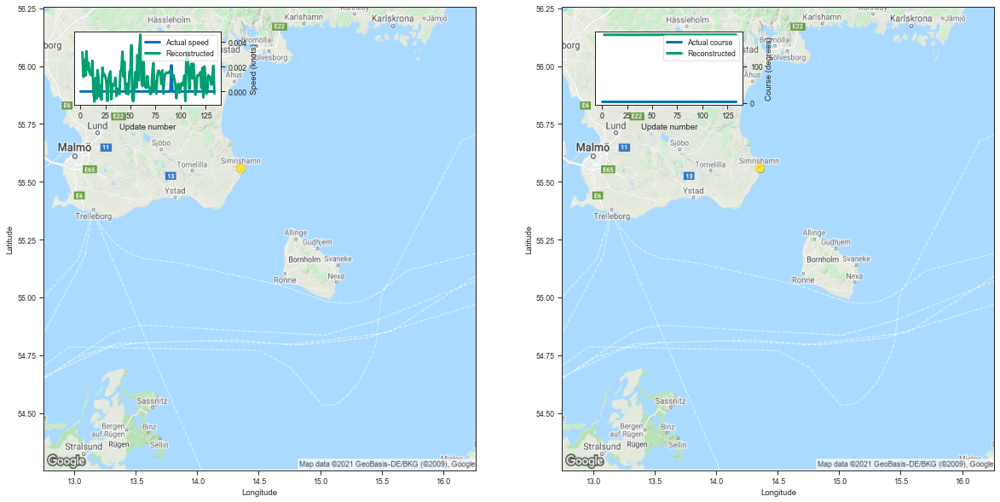

[0.0031723976135253906, 0.0011849403381347656, 0.0025634765625, 0.001277923583984375]


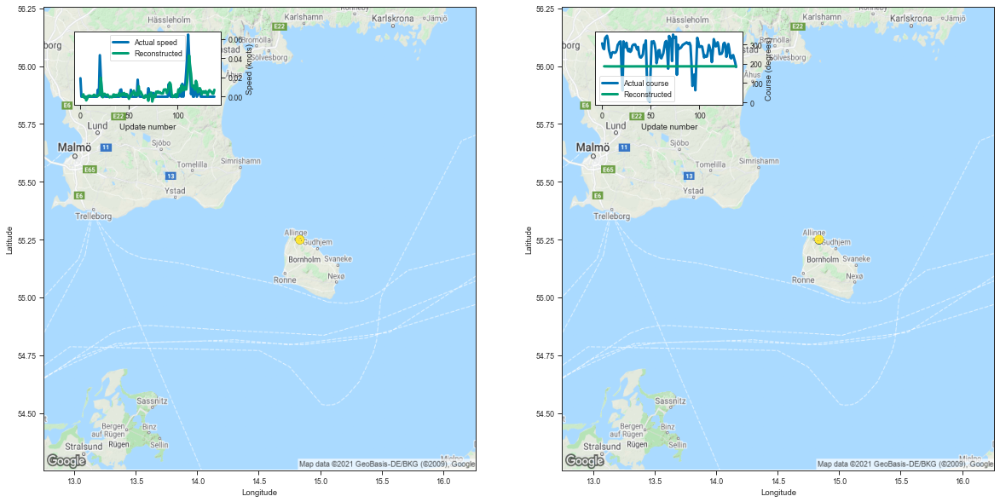

[0.00014472007751464844, 0.0024542808532714844, -0.0010085105895996094, -0.0004673004150390625]


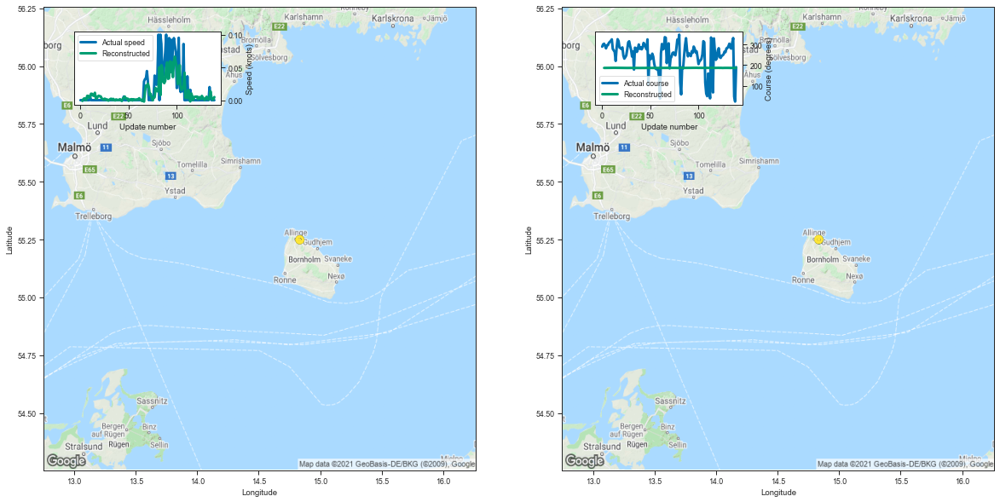

[-0.0011560916900634766, 0.0014758110046386719, 0.0027801990509033203, 0.0020470619201660156]


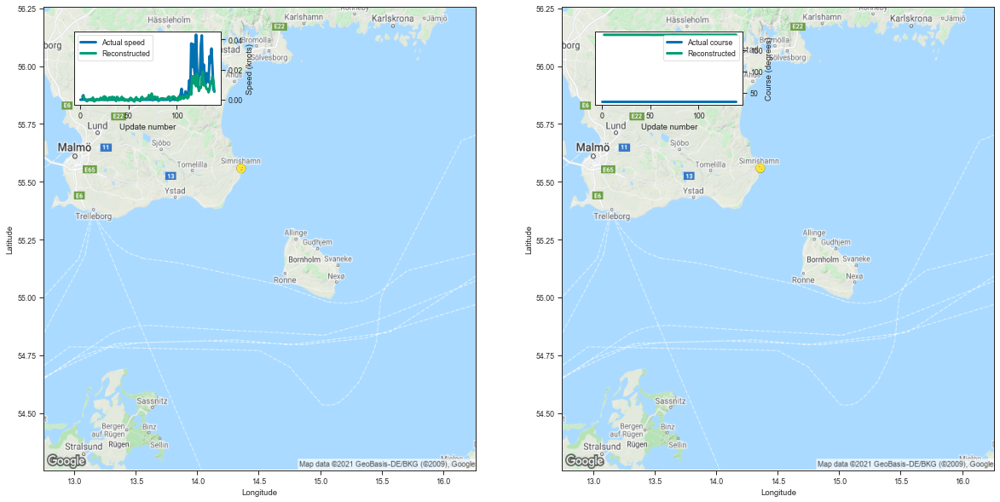

[0.002238750457763672, 0.0019125938415527344, 0.001088857650756836, 0.00017404556274414062]


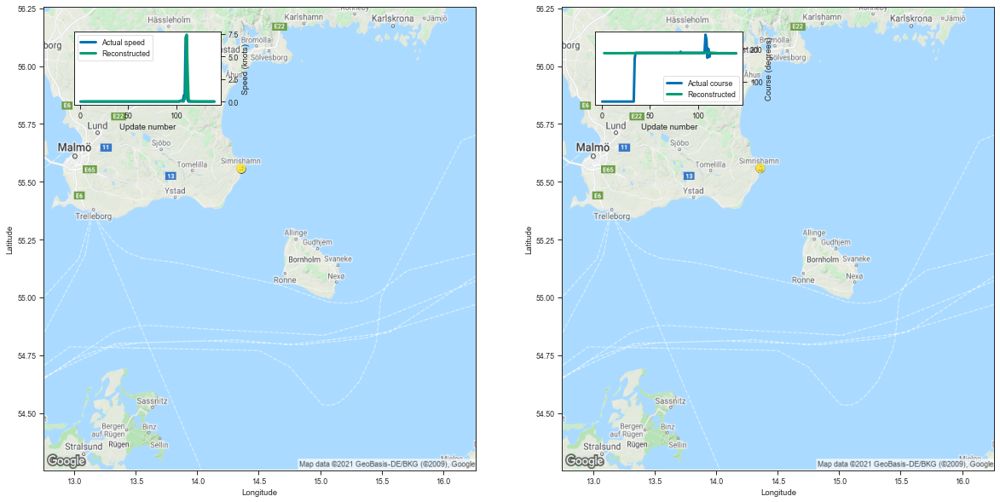

[-0.0012583732604980469, -0.00043845176696777344, -5.7697296142578125e-05, 0.0014810562133789062]


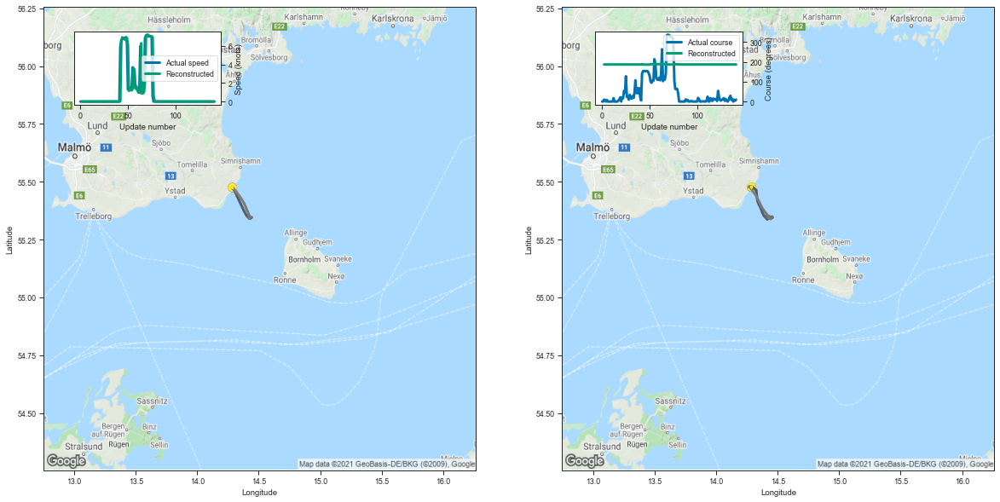

[0.0047626495361328125, -0.0014772415161132812, -0.002277851104736328, -0.00145721435546875]


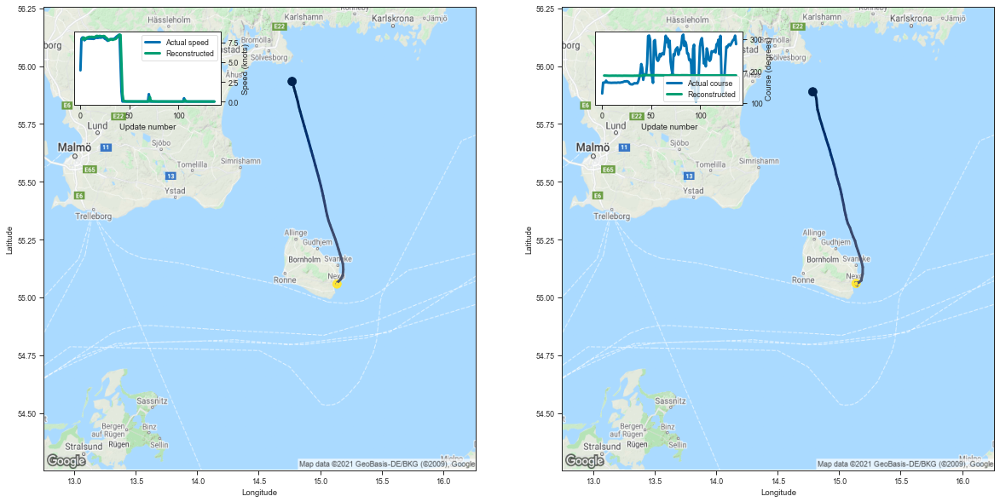

[7.890918254852295, 8.119706153869629, 8.103114128112793, 7.895035266876221]


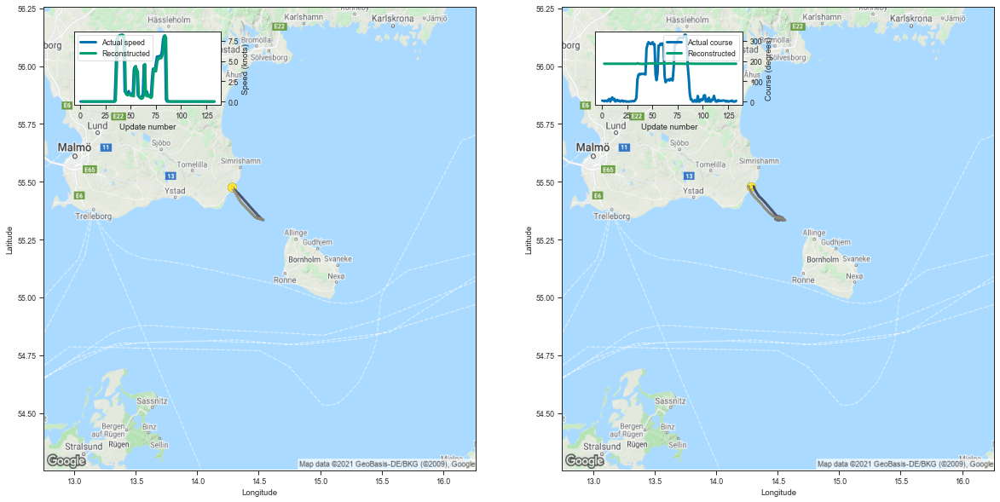

[0.0029191970825195312, -0.0013604164123535156, -0.0026900768280029297, 0.00018143653869628906]


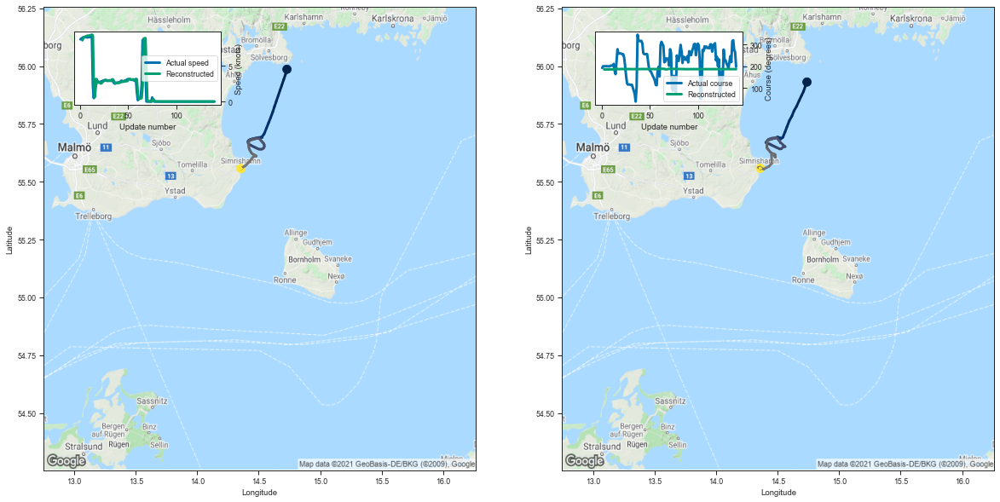

[8.557769775390625, 8.882036209106445, 9.005640983581543, 9.075794219970703]


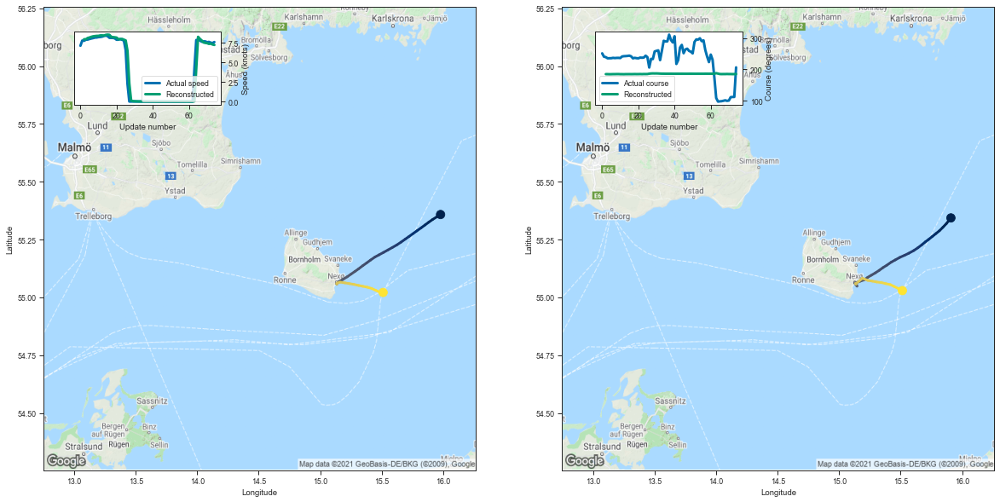

[7.943392276763916, 7.938572406768799, 8.101255416870117, 8.164865493774414]


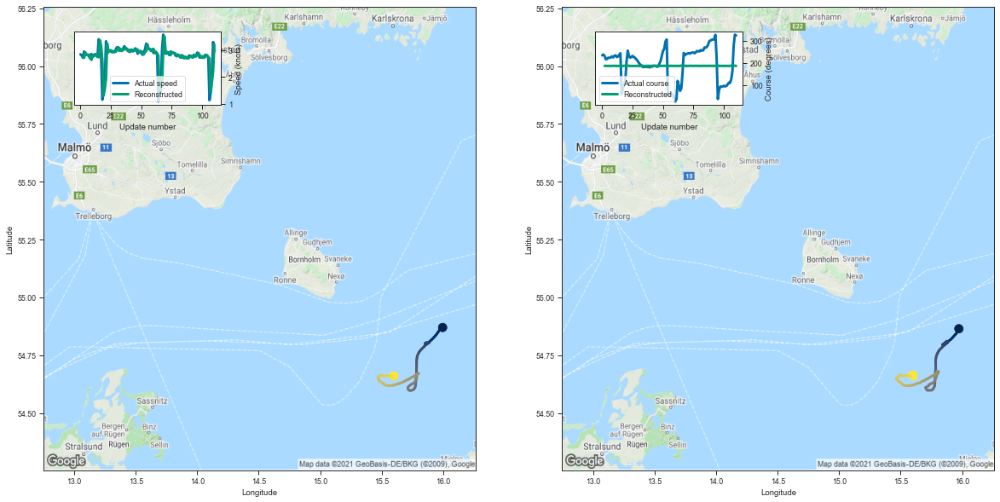

[2.758229970932007, 2.704921245574951, 2.9074249267578125, 2.808199644088745]


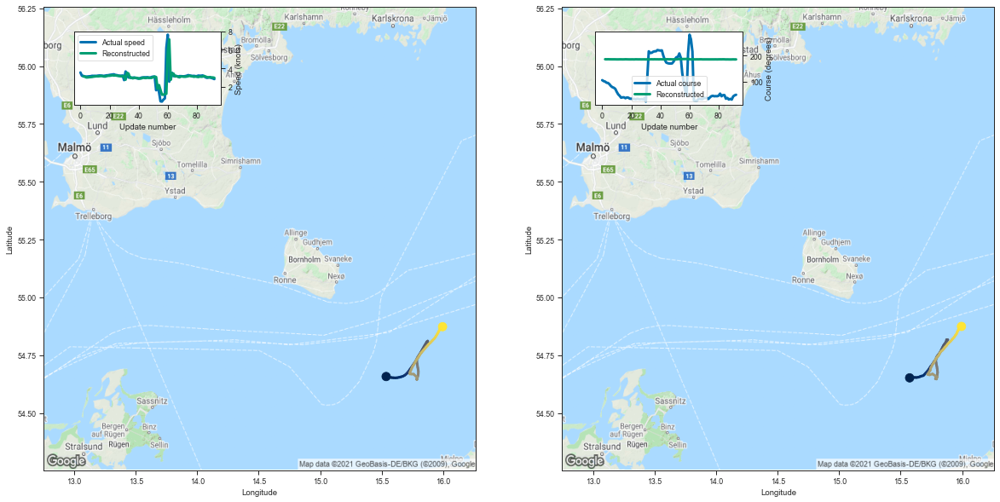

[3.1151890754699707, 3.1133856773376465, 3.011462450027466, 3.0185093879699707]


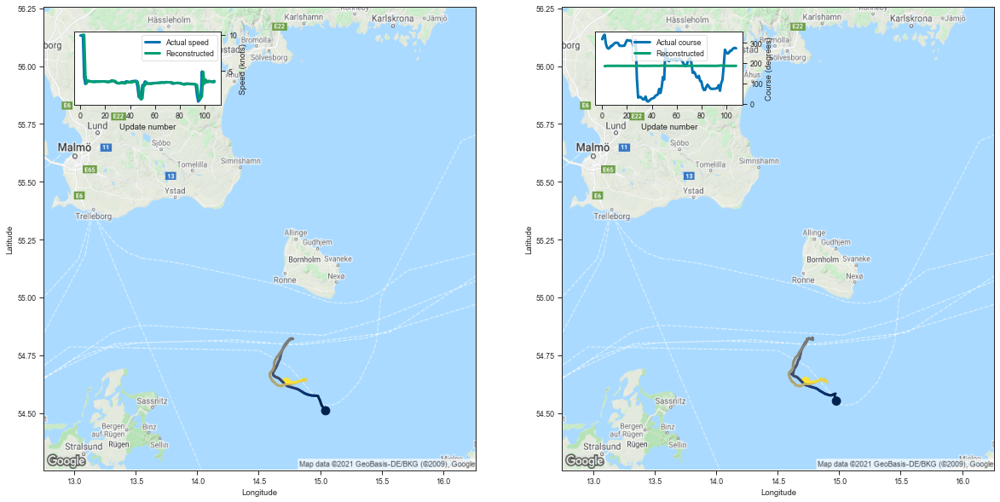

[10.027425765991211, 9.992725372314453, 4.353754043579102, 3.247067451477051]


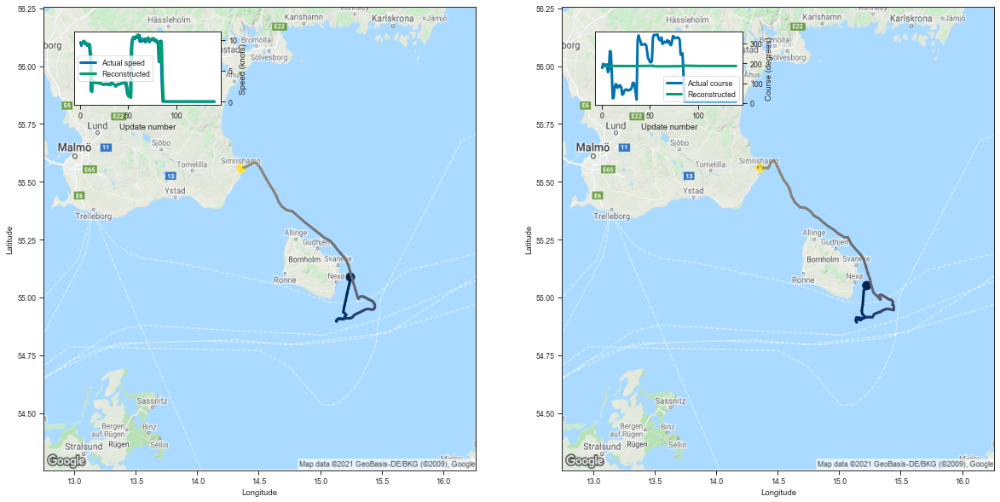

[9.388614654541016, 9.811495780944824, 9.778230667114258, 9.599953651428223]


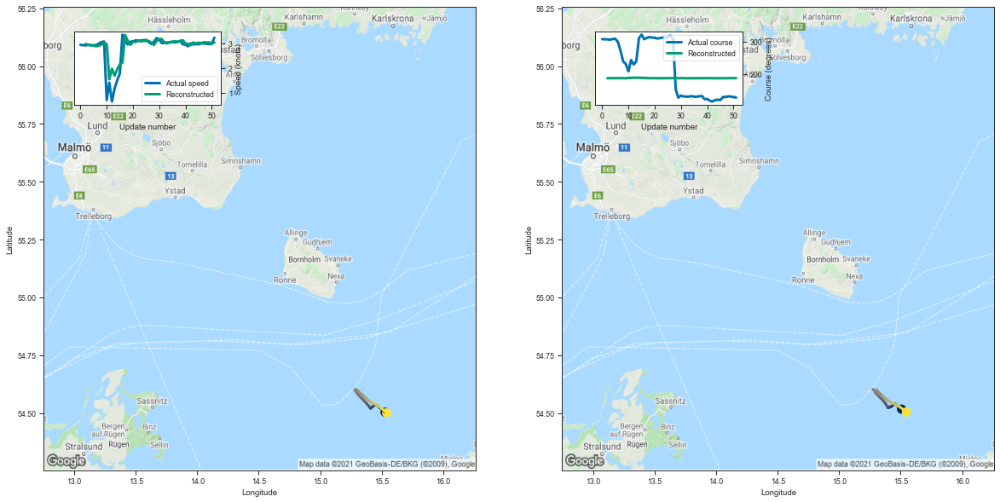

[2.9717302322387695, 2.9341211318969727, 2.9179563522338867, 2.9009077548980713]


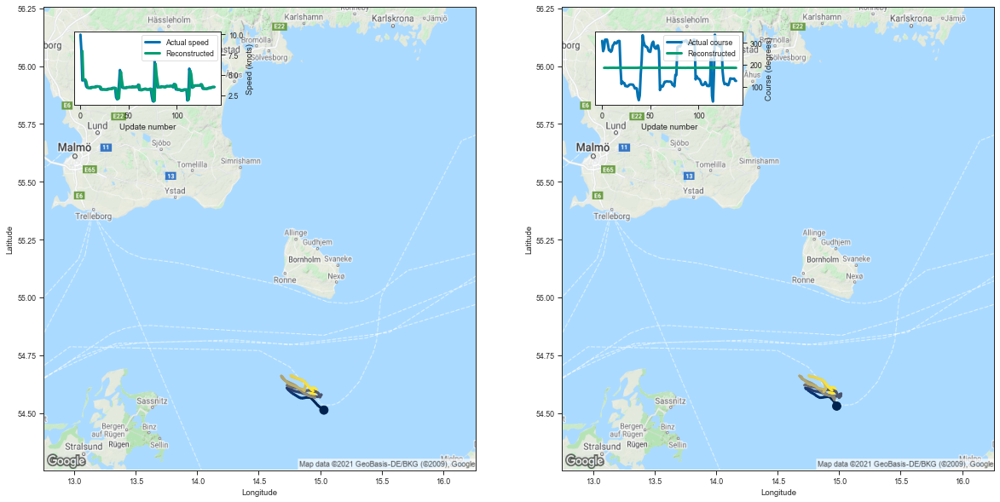

[7.956573486328125, 4.510021209716797, 4.40305757522583, 4.437028884887695]


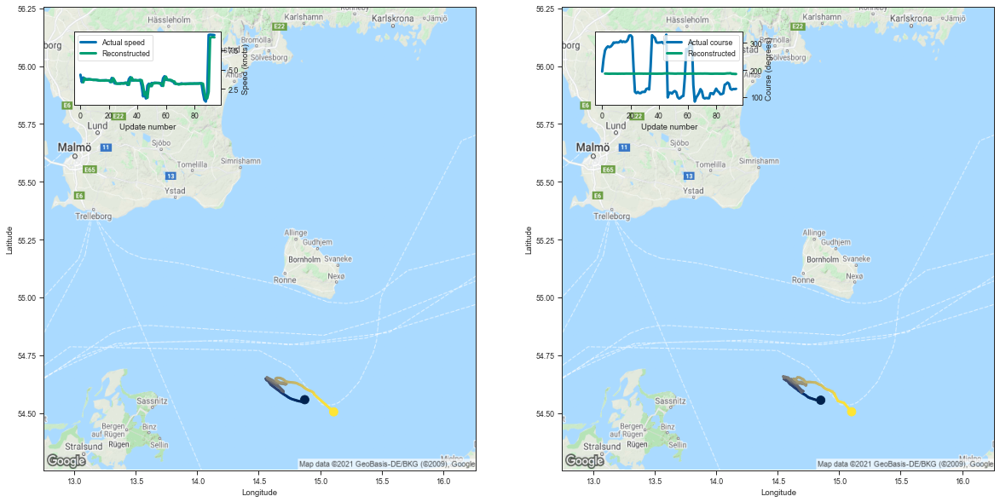

[3.3600192070007324, 3.8871800899505615, 3.705503463745117, 3.7007651329040527]


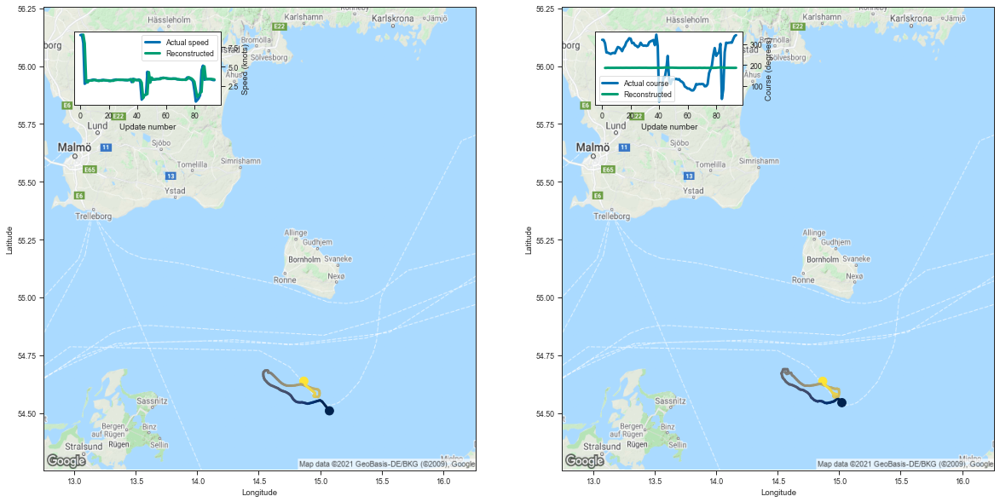

[9.077310562133789, 7.955891132354736, 3.0814476013183594, 2.960202932357788]


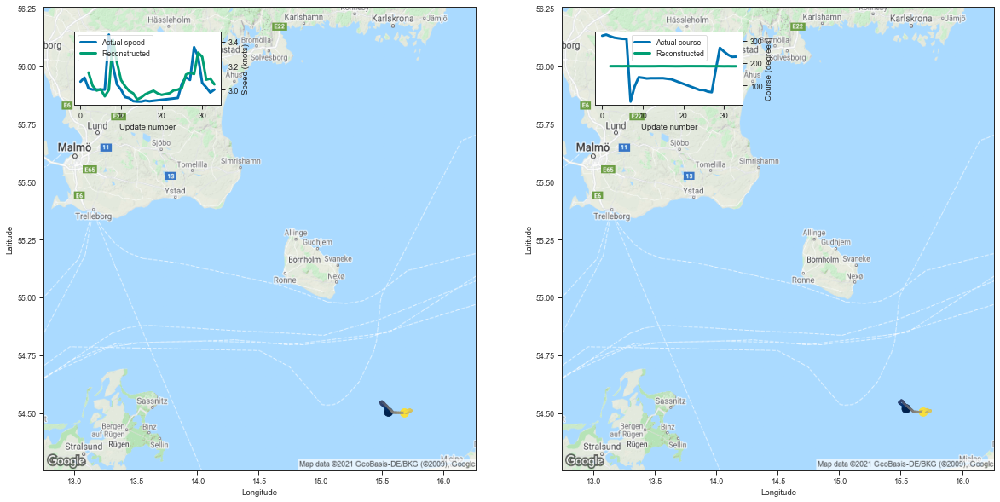

[3.142874240875244, 3.0320775508880615, 2.9923043251037598, 3.0028159618377686]


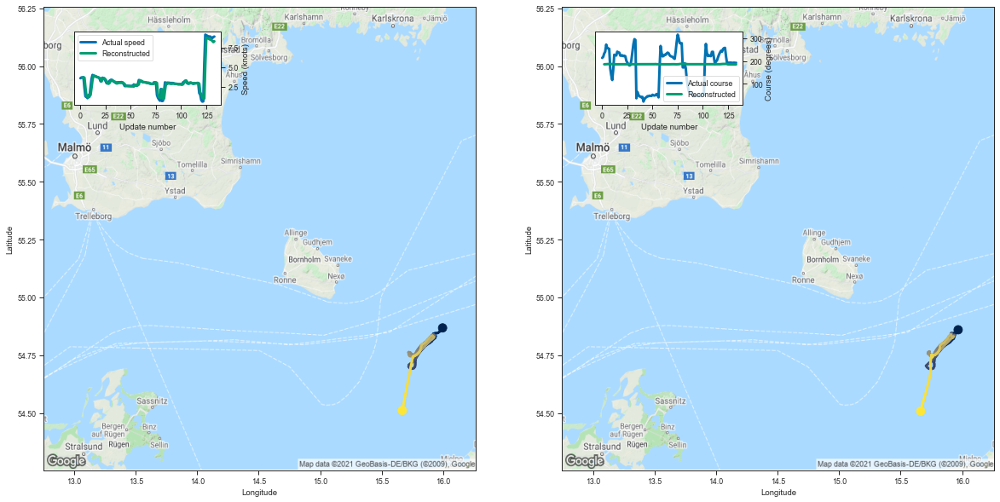

[3.6622045040130615, 3.713770866394043, 3.6710429191589355, 2.4059202671051025]


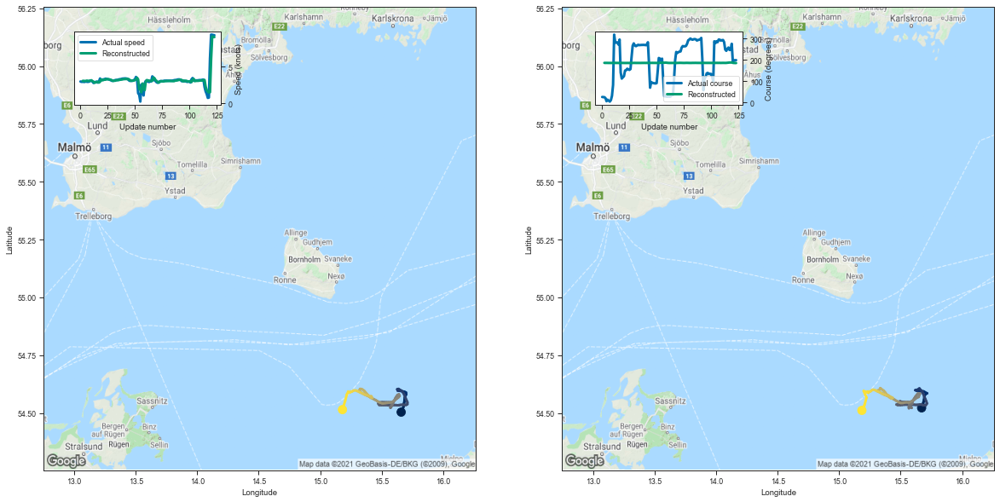

[3.074451446533203, 3.081298828125, 3.053960084915161, 3.070418357849121]


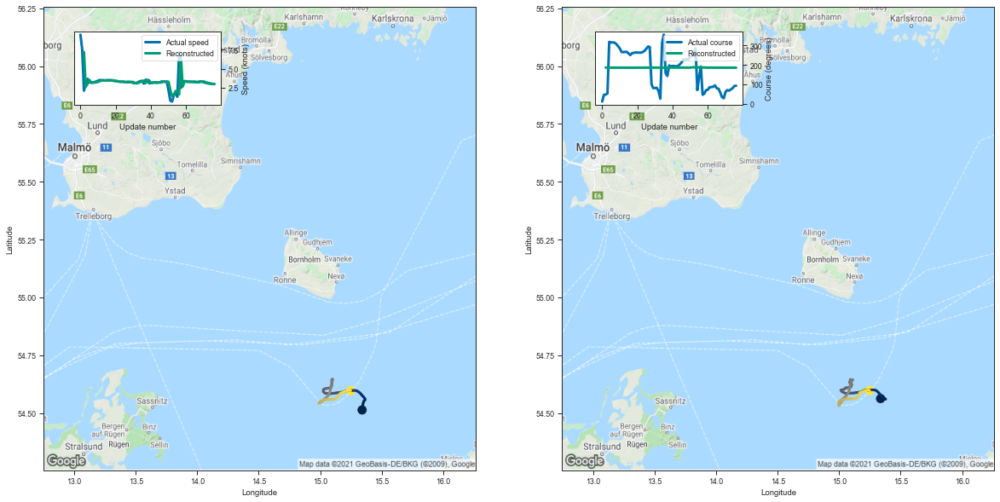

[7.199887752532959, 2.6262967586517334, 3.0045924186706543, 3.5459327697753906]


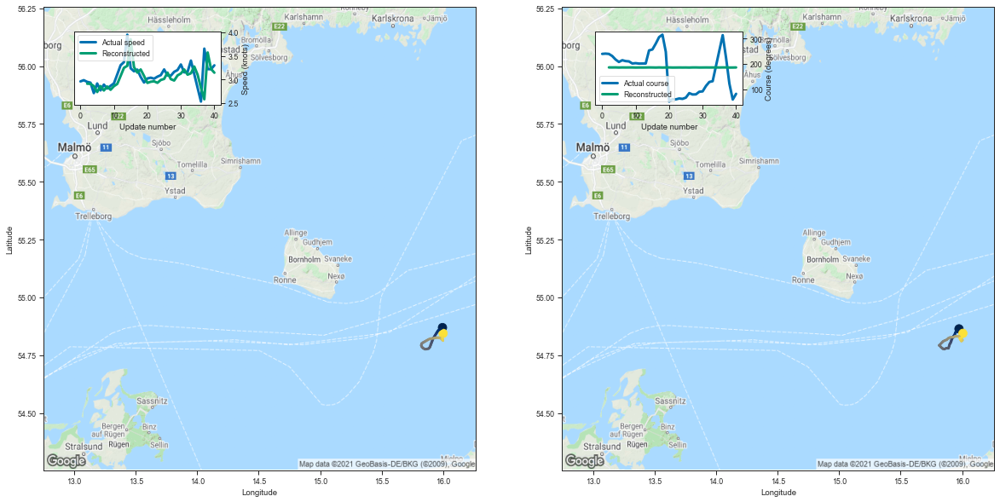

[2.910538911819458, 2.9074742794036865, 2.8598787784576416, 2.733703374862671]


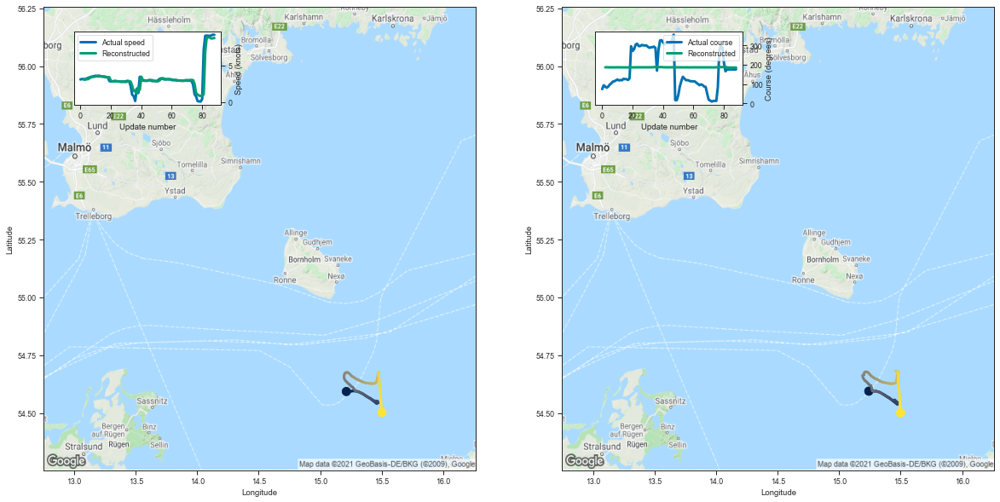

[3.1024720668792725, 3.045508861541748, 3.1125986576080322, 3.122624397277832]


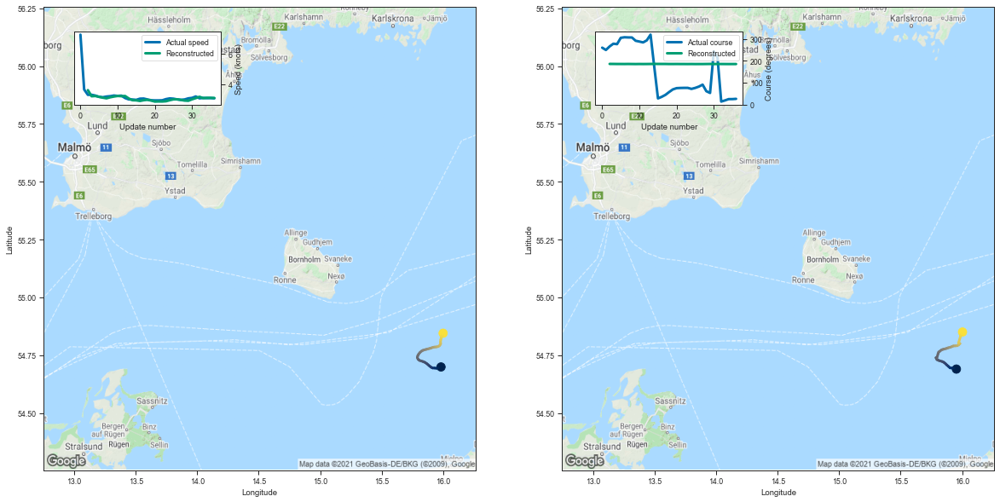

[3.5928757190704346, 3.186680793762207, 3.2021894454956055, 3.148430347442627]


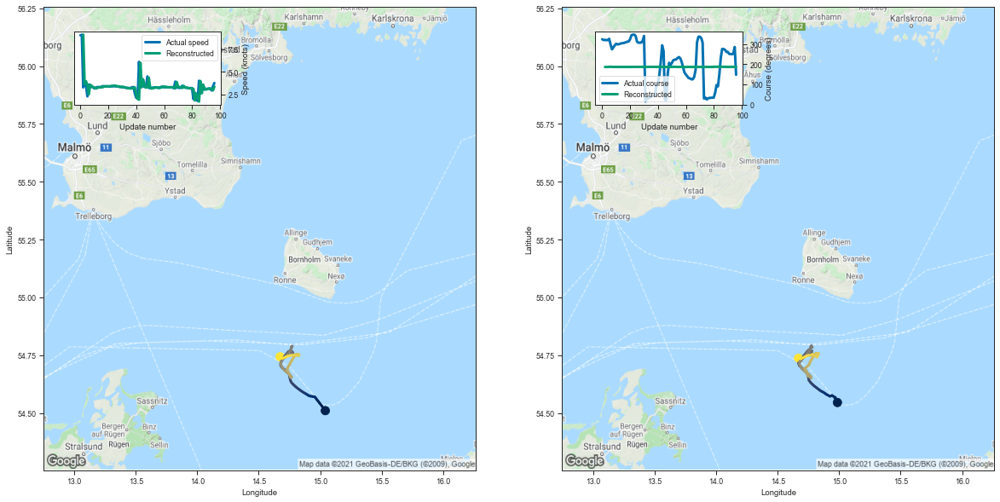

[9.129852294921875, 3.6510114669799805, 3.9596829414367676, 3.4653947353363037]


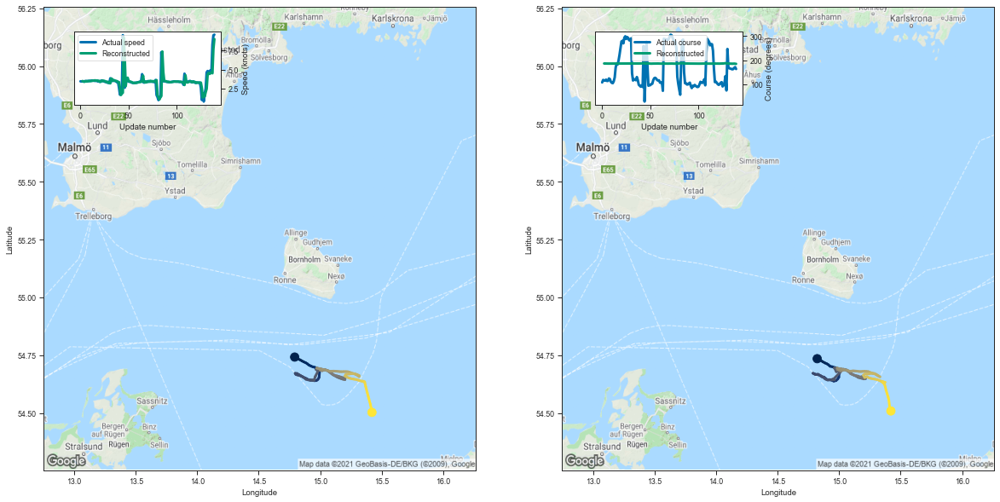

[3.4881432056427, 3.4641594886779785, 3.391939640045166, 3.4349279403686523]


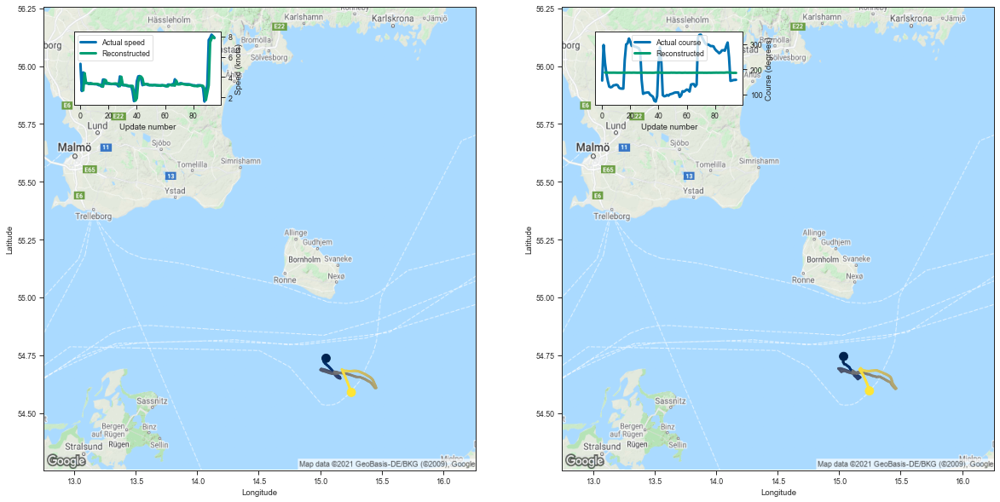

[2.677896738052368, 4.390622138977051, 3.417579174041748, 3.4051129817962646]


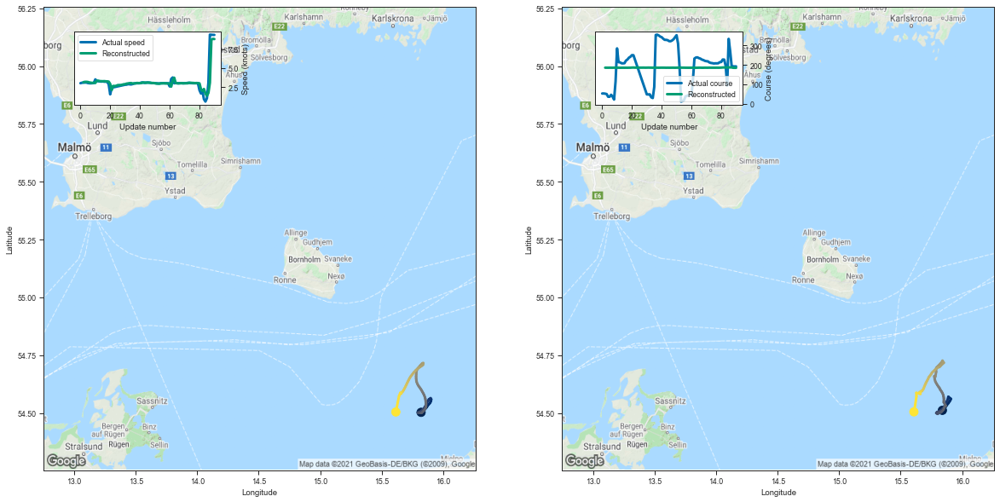

[3.1434202194213867, 3.1848061084747314, 3.1866703033447266, 3.16751766204834]


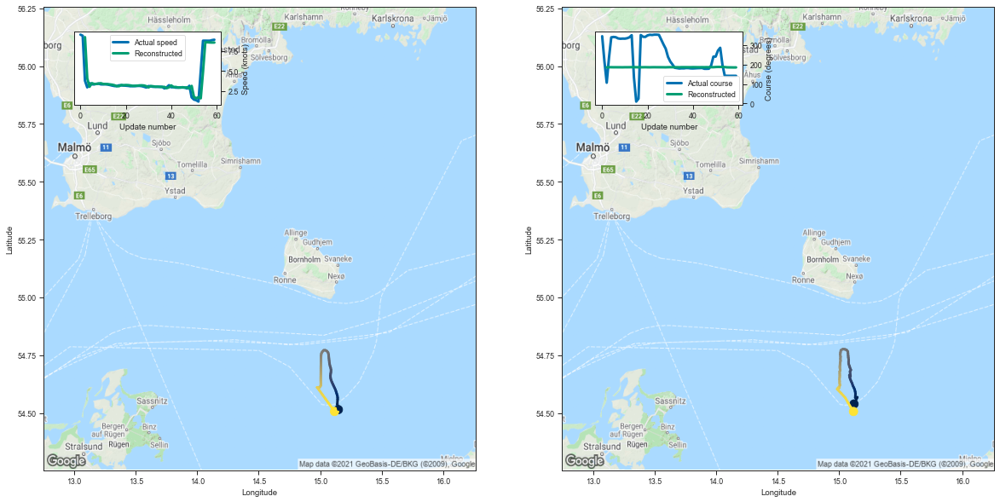

[9.23462963104248, 4.056576728820801, 3.002673387527466, 3.4631028175354004]


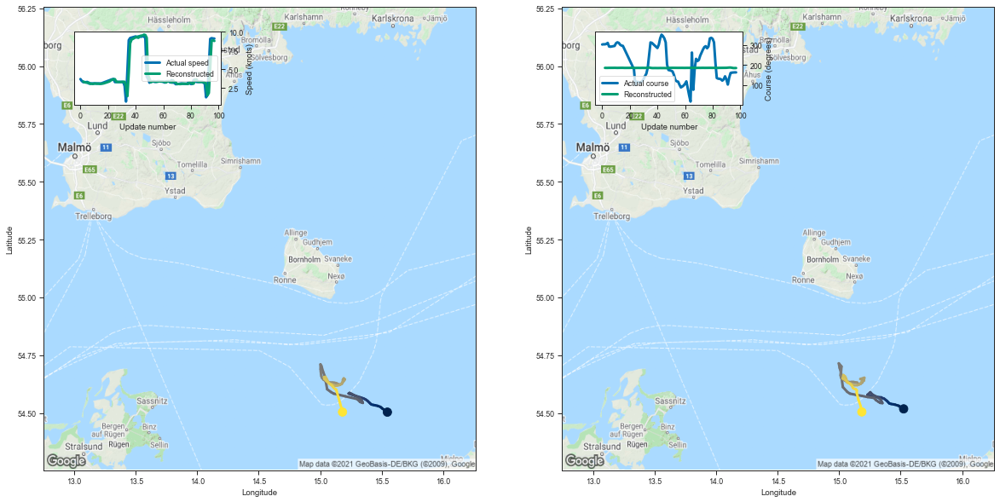

[3.3629150390625, 3.265984535217285, 3.218505620956421, 3.188044548034668]


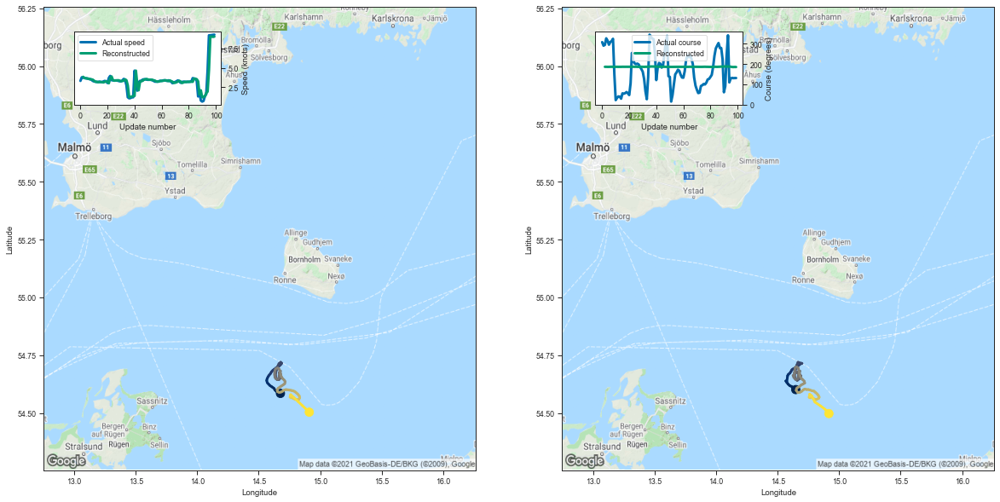

[3.8398938179016113, 3.687136173248291, 3.6569275856018066, 3.625080108642578]


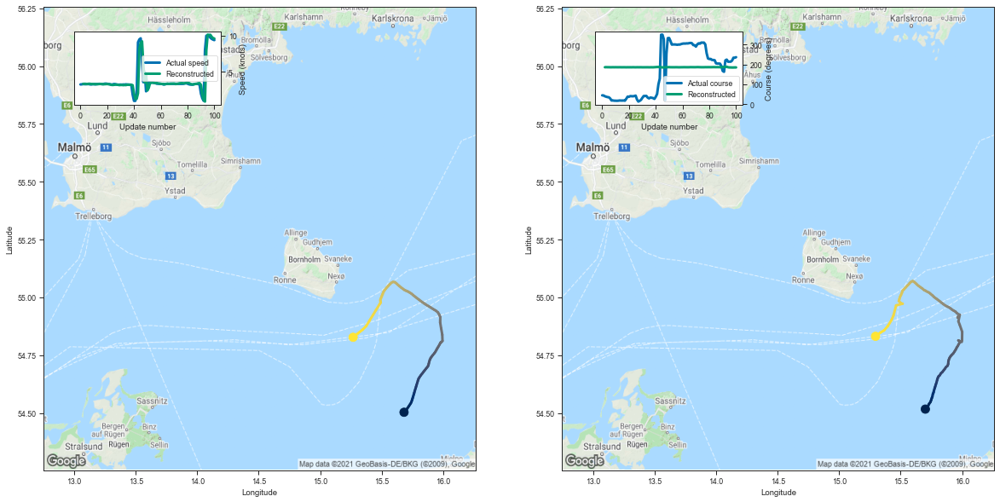

[3.2943220138549805, 3.306835651397705, 3.299597978591919, 3.2680845260620117]


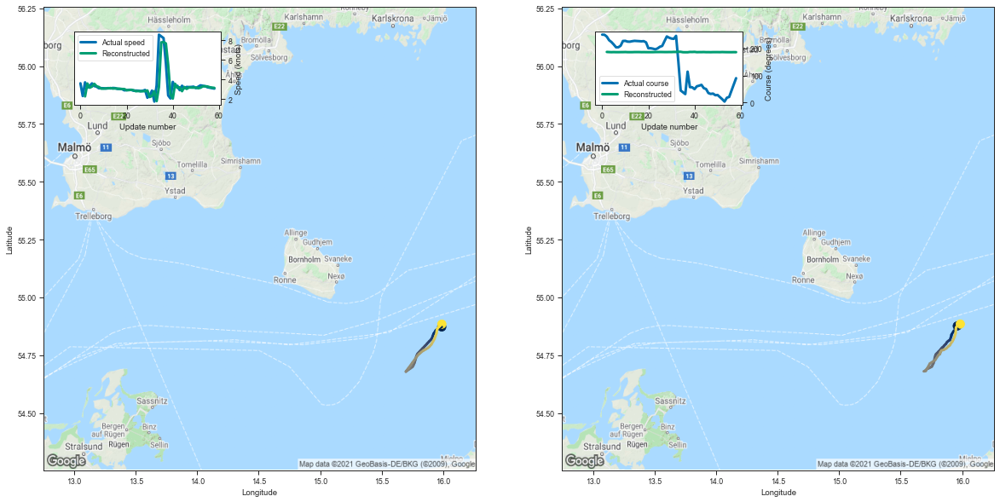

[2.2641031742095947, 3.5835587978363037, 3.151906728744507, 3.2690272331237793]


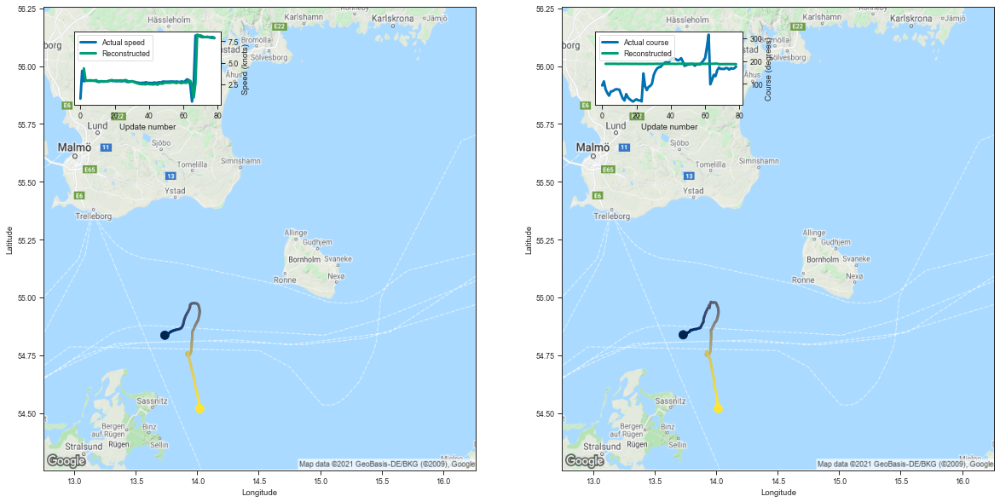

[4.338844299316406, 2.9798121452331543, 2.917141914367676, 2.917217969894409]


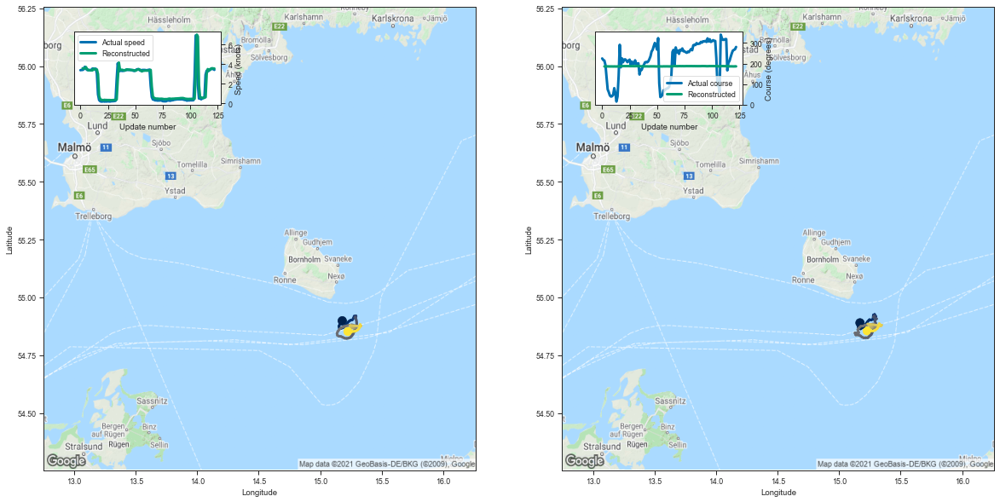

[3.569511890411377, 3.537594795227051, 3.5374934673309326, 3.693233013153076]


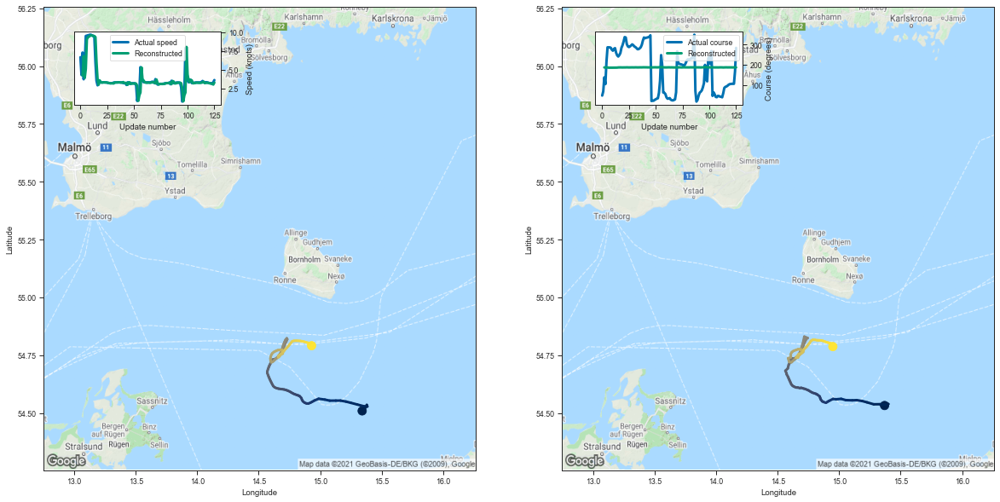

[4.221728324890137, 6.815667629241943, 3.9031975269317627, 5.108330726623535]


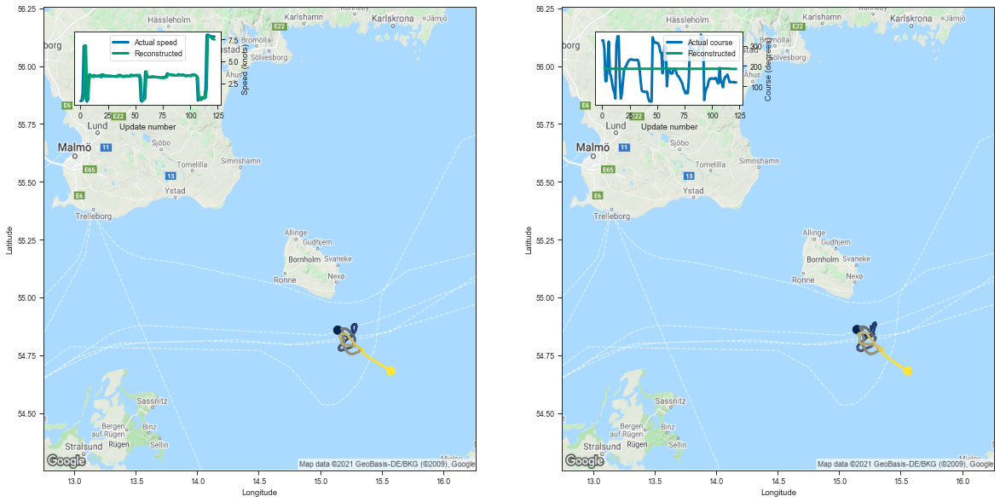

[0.5441588163375854, 1.0689611434936523, 6.825501441955566, 6.795835971832275]


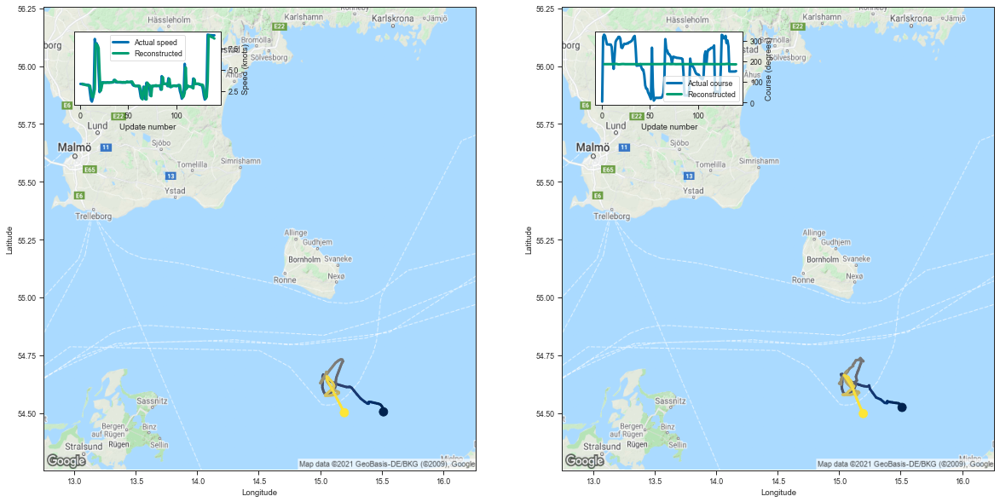

[3.3689403533935547, 3.296391010284424, 3.2793872356414795, 3.23781418800354]


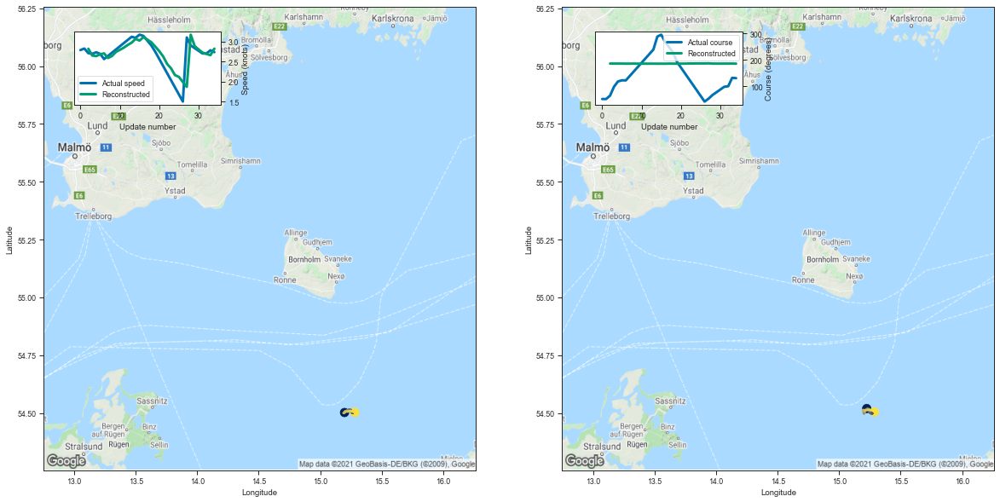

[2.8174004554748535, 2.64971923828125, 2.6333630084991455, 2.680734157562256]


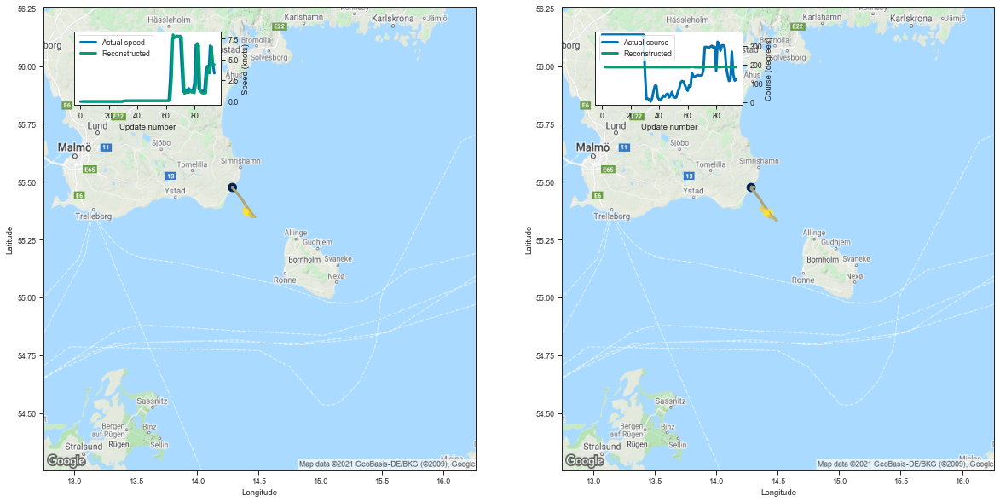

[-0.07740545272827148, -0.08641266822814941, -0.08837175369262695, -0.08666539192199707]


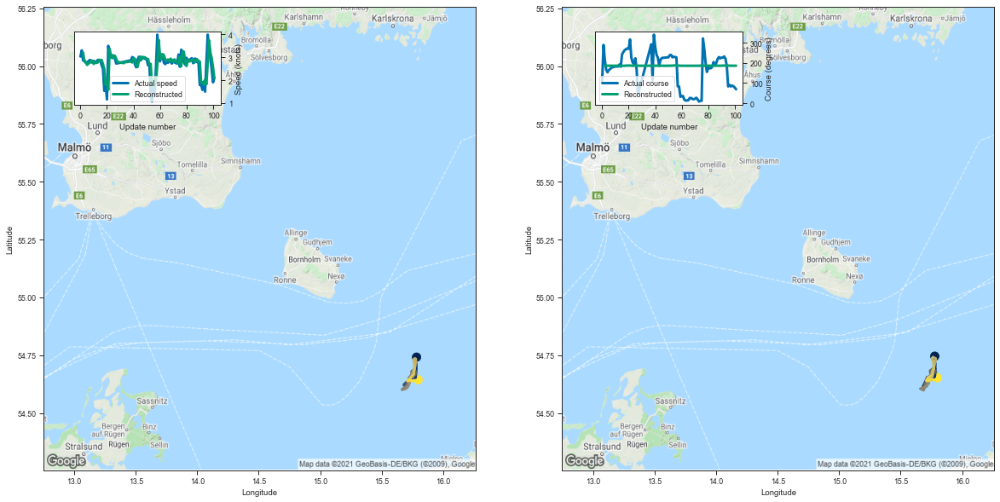

[3.2028141021728516, 2.8255233764648438, 2.800621747970581, 2.6675162315368652]


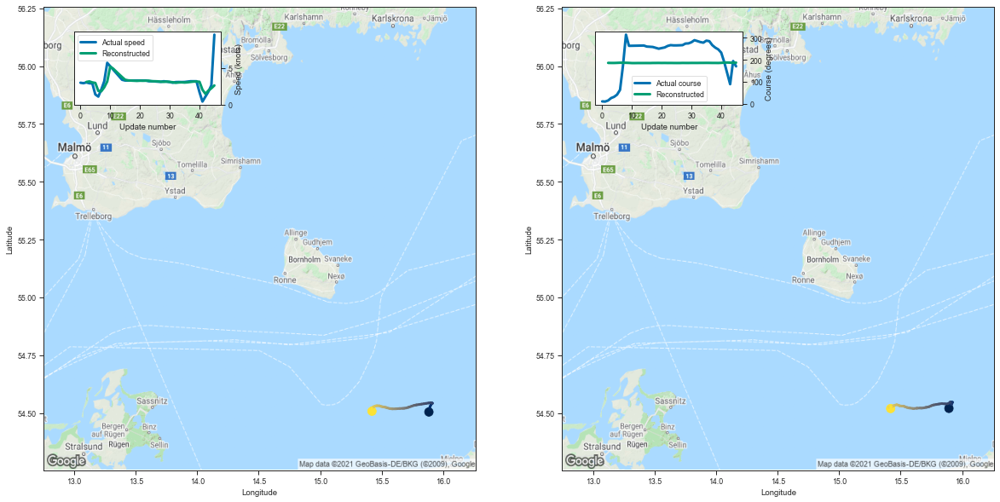

[3.104780673980713, 3.176961898803711, 3.0426032543182373, 2.969646692276001]


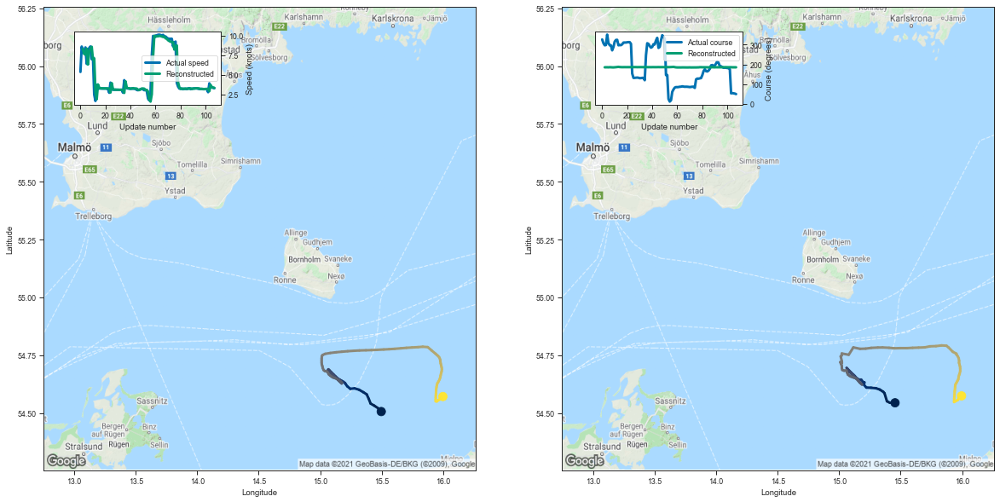

[8.312682151794434, 7.671064853668213, 7.591289520263672, 8.351211547851562]


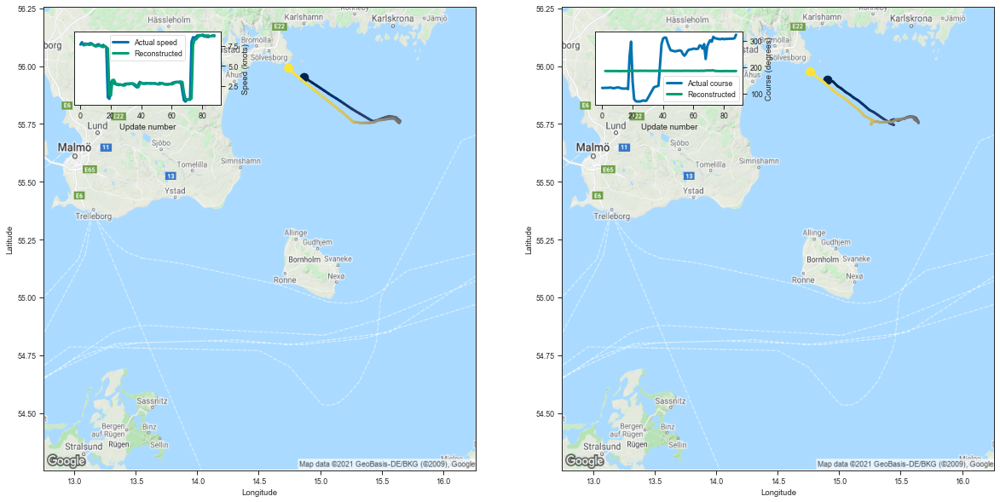

[7.7952046394348145, 7.597899913787842, 7.715231895446777, 7.68430757522583]


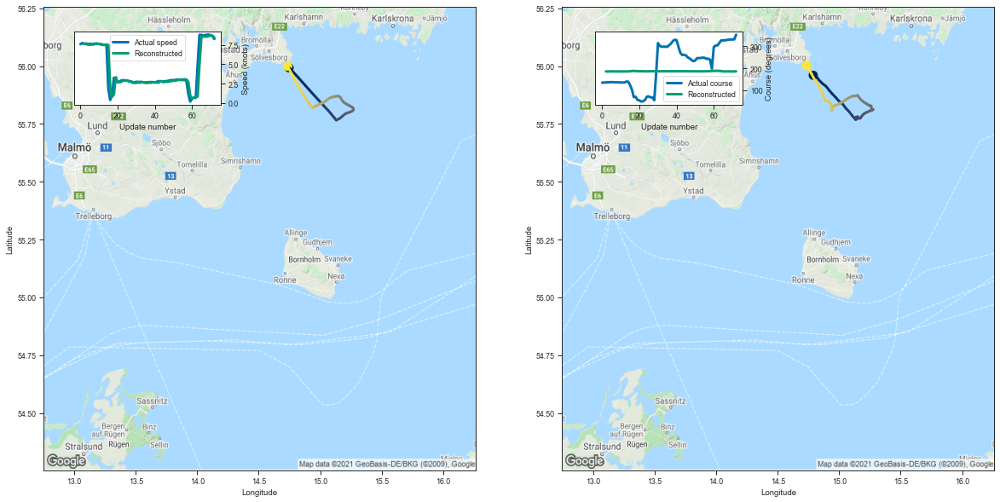

[7.613762855529785, 7.69342565536499, 7.604883193969727, 7.509654521942139]


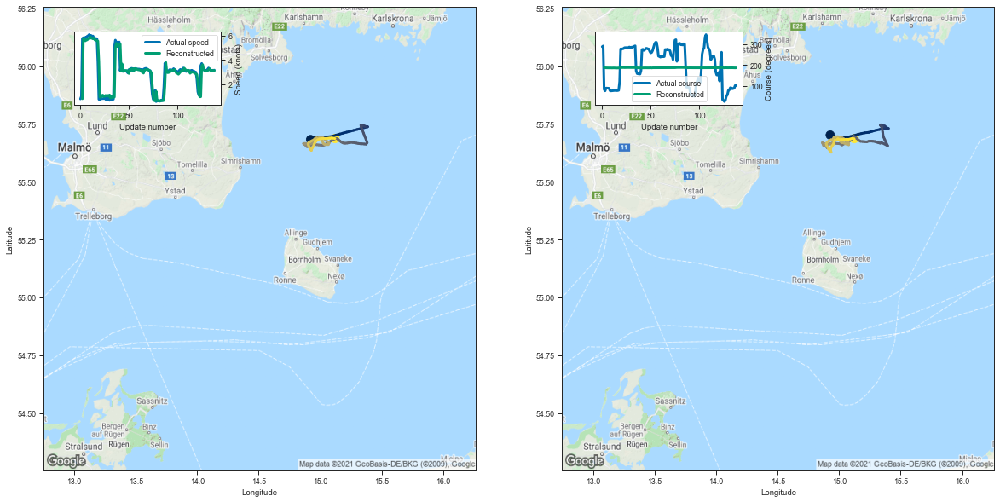

[0.7918581962585449, 5.787969589233398, 5.716216087341309, 5.578970909118652]


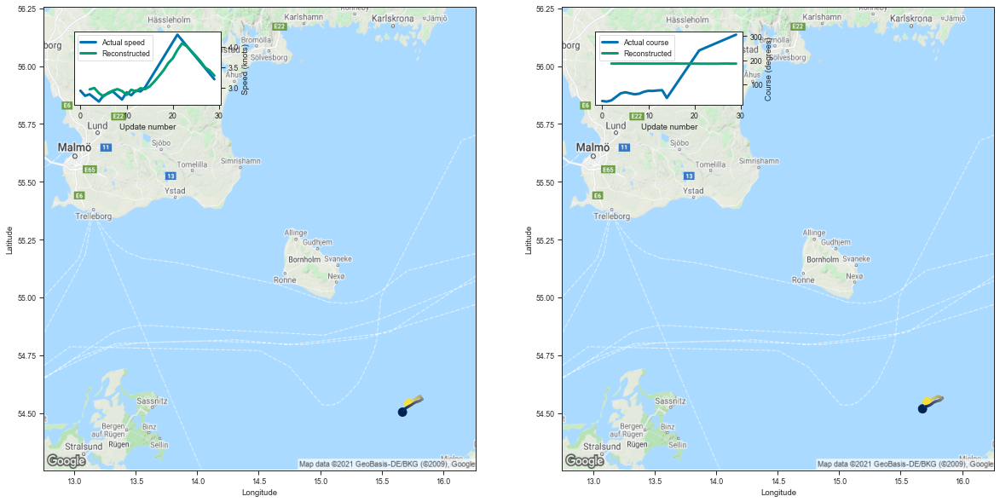

[2.9508423805236816, 2.9844374656677246, 2.8579418659210205, 2.776681900024414]


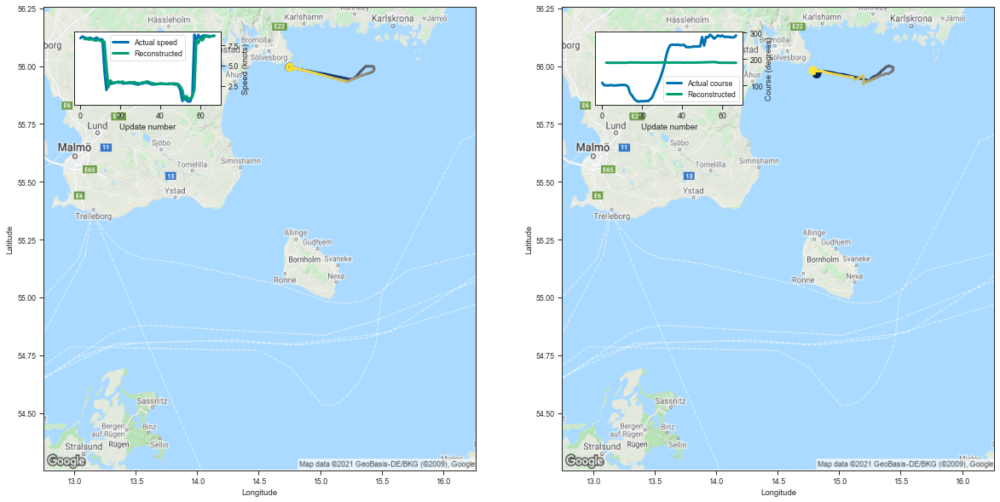

[8.260802268981934, 8.310949325561523, 8.22409439086914, 8.228119850158691]


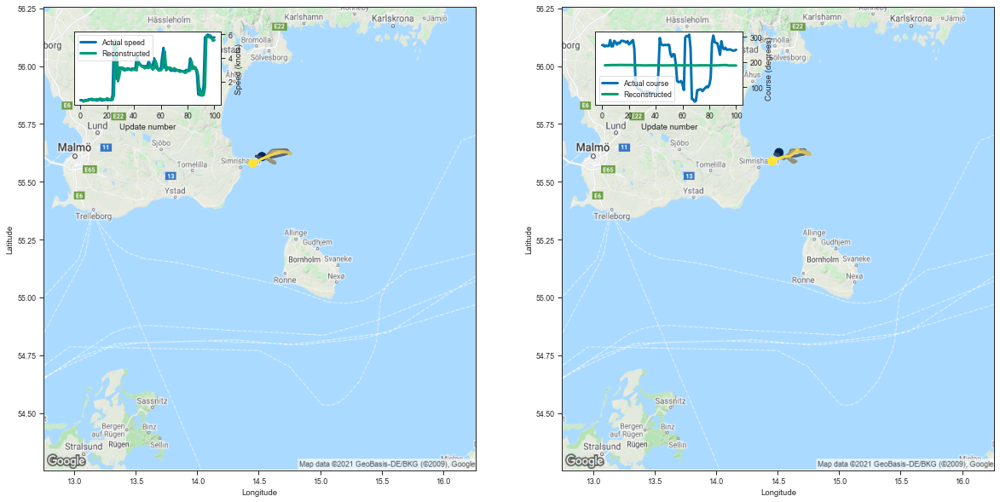

[0.2989286184310913, 0.3317214250564575, 0.36800503730773926, 0.41413795948028564]


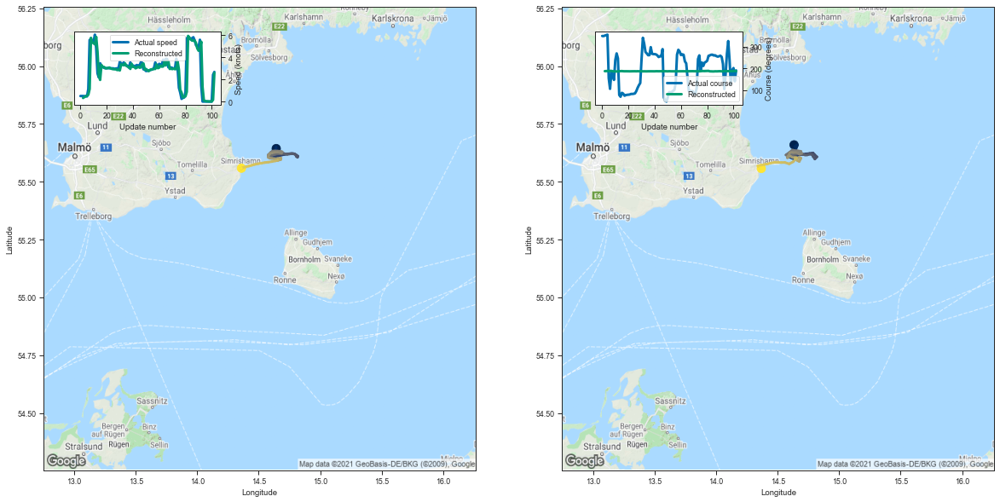

[0.3226490020751953, 0.4089277982711792, 0.4613908529281616, 0.5284758806228638]


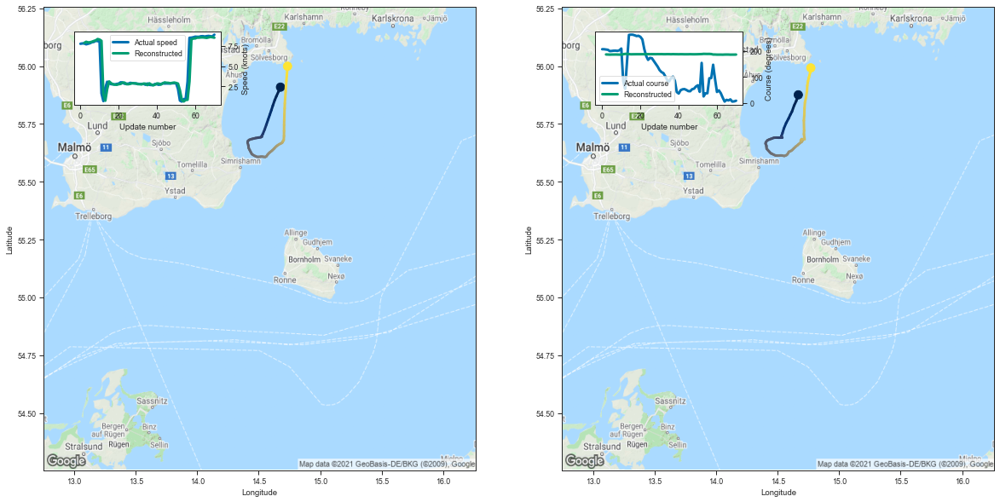

[7.883285045623779, 8.015823364257812, 7.942049980163574, 7.9539570808410645]


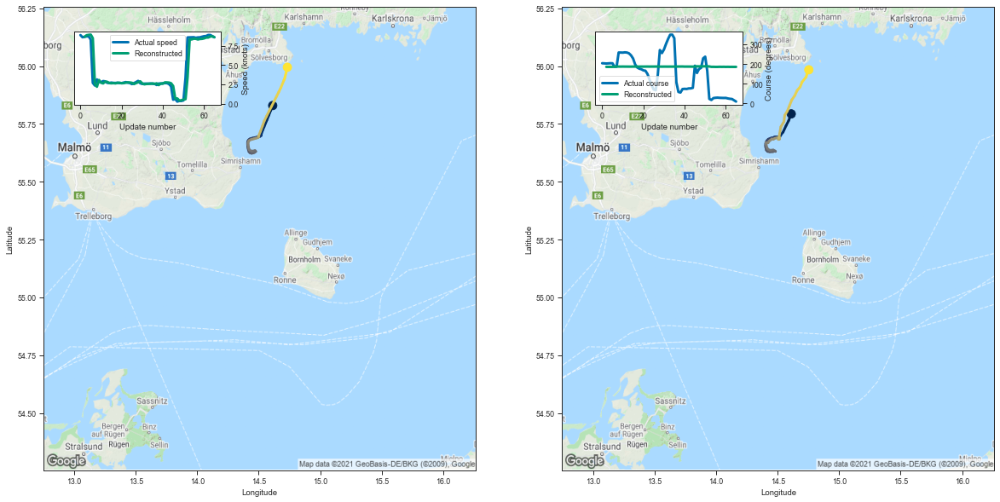

[8.663304328918457, 8.868814468383789, 8.917739868164062, 8.946768760681152]


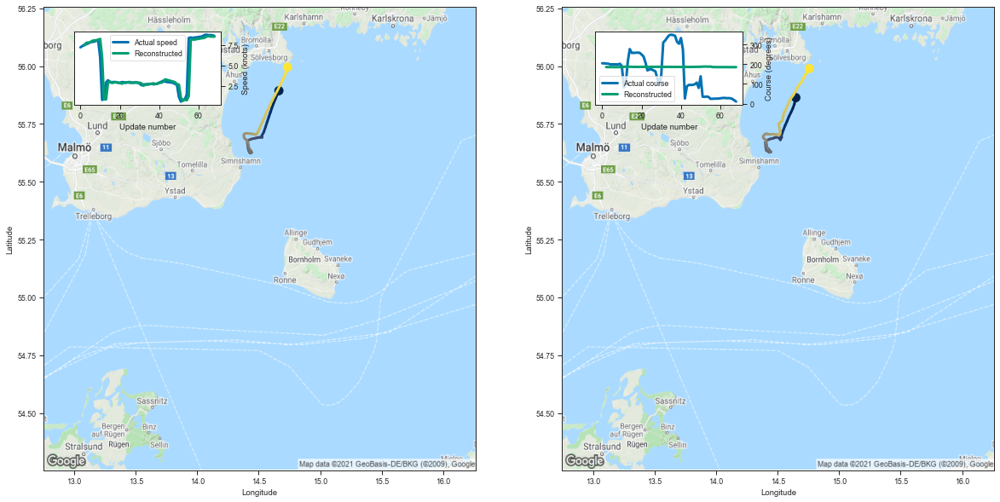

[7.43803071975708, 7.765908718109131, 7.784794330596924, 7.846410274505615]


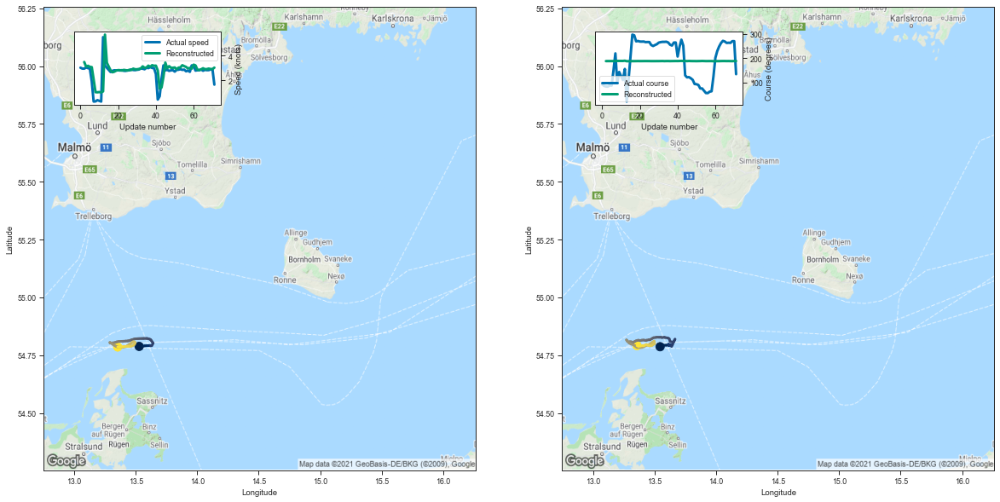

[3.4953253269195557, 3.1211929321289062, 3.1869540214538574, 3.103869915008545]


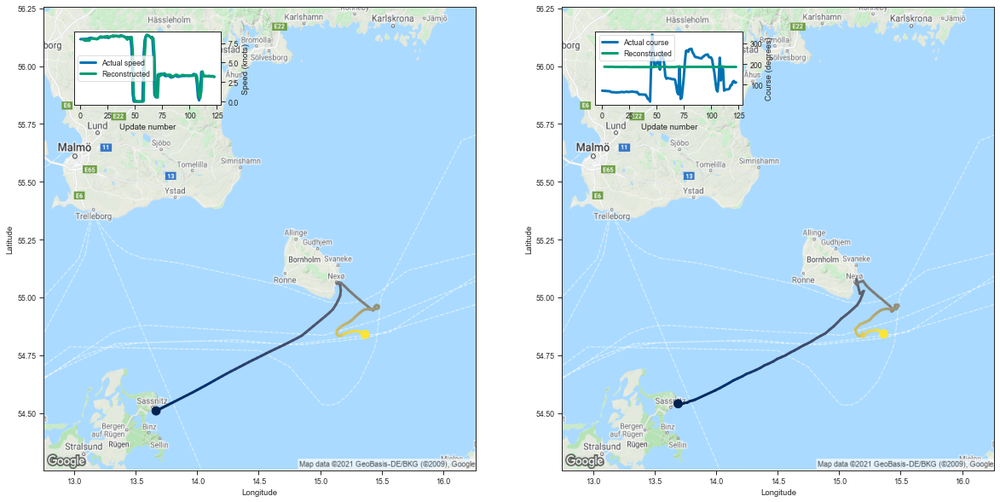

[8.011269569396973, 7.919191837310791, 7.812644004821777, 7.930744647979736]


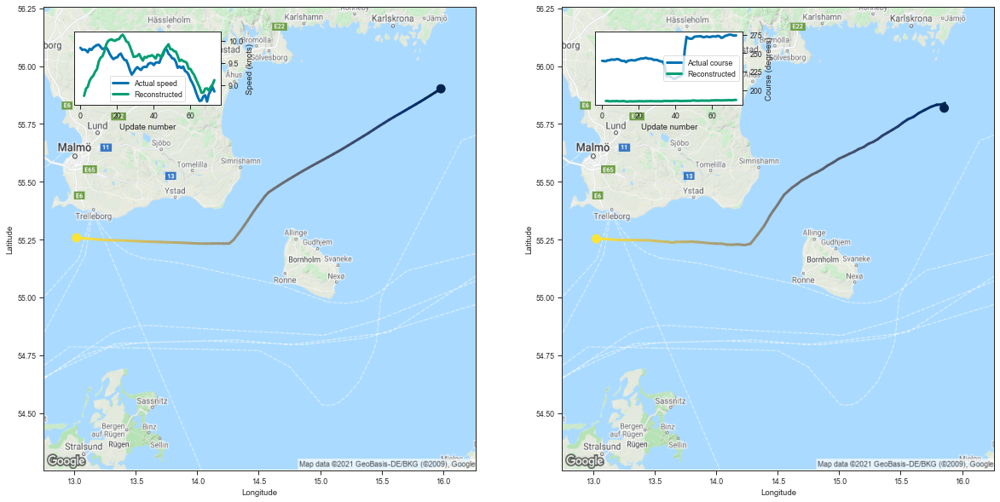

[8.750204086303711, 8.910490989685059, 8.9552583694458, 9.091513633728027]


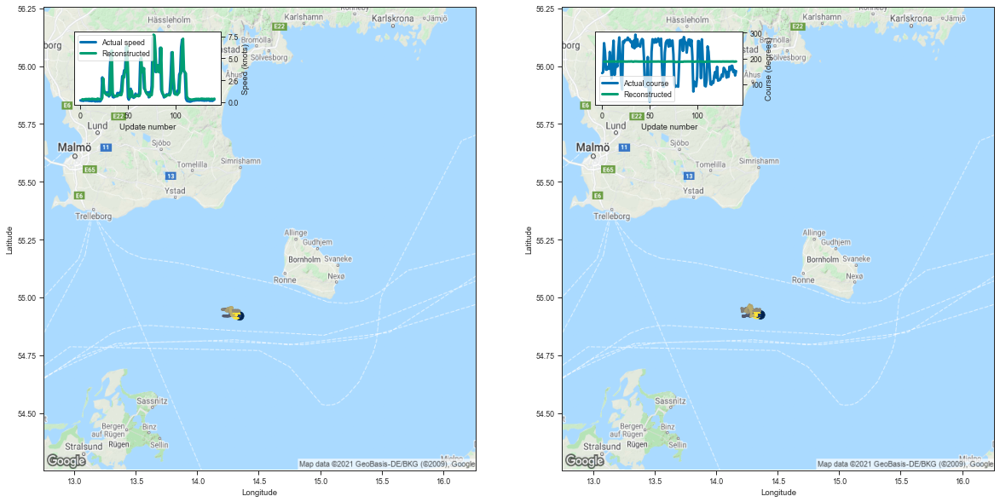

[0.32281219959259033, 0.29741406440734863, 0.30334460735321045, 0.33557796478271484]


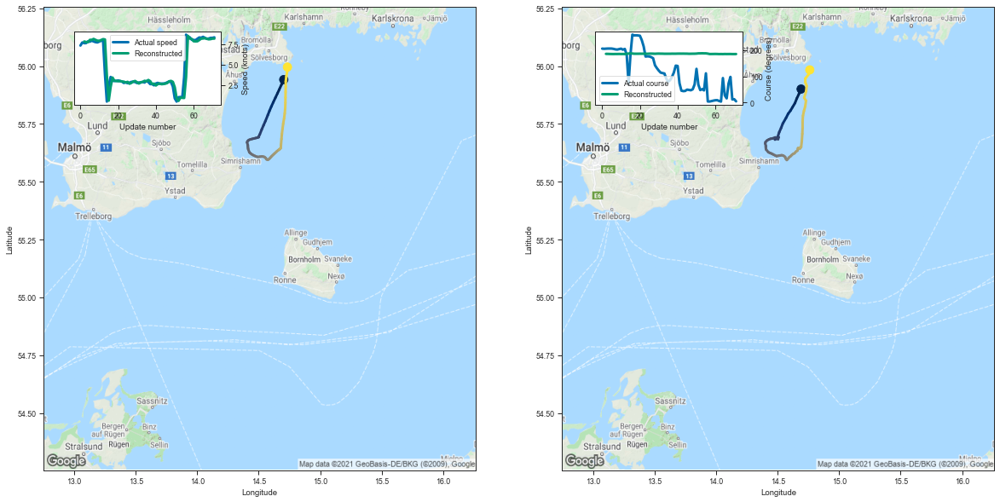

[7.830016136169434, 7.762381076812744, 7.749270439147949, 8.024362564086914]


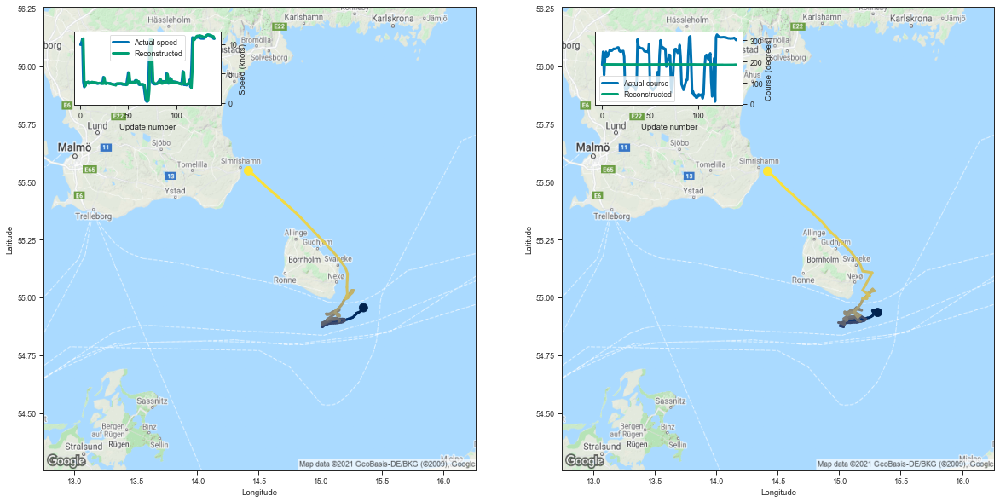

[10.565383911132812, 10.908304214477539, 3.772254705429077, 2.8533411026000977]


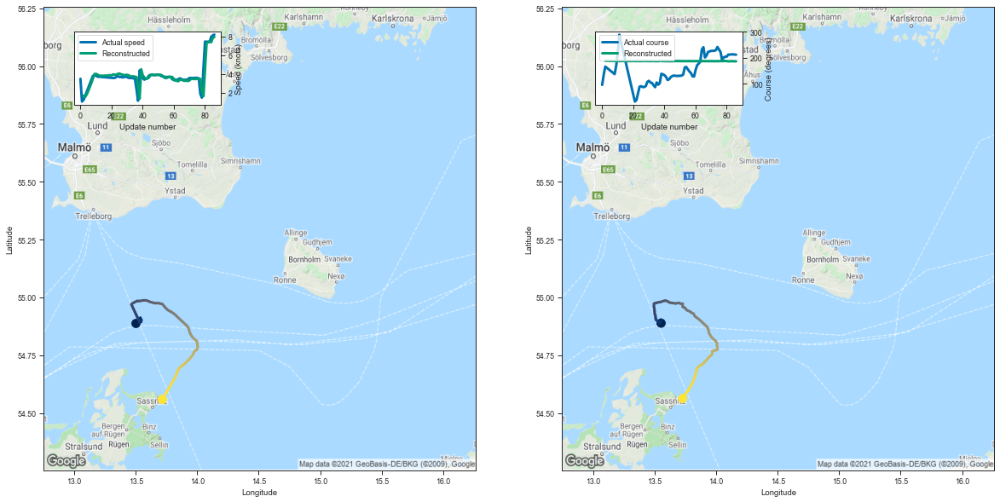

[1.7069313526153564, 1.5730924606323242, 1.821645736694336, 2.2068557739257812]


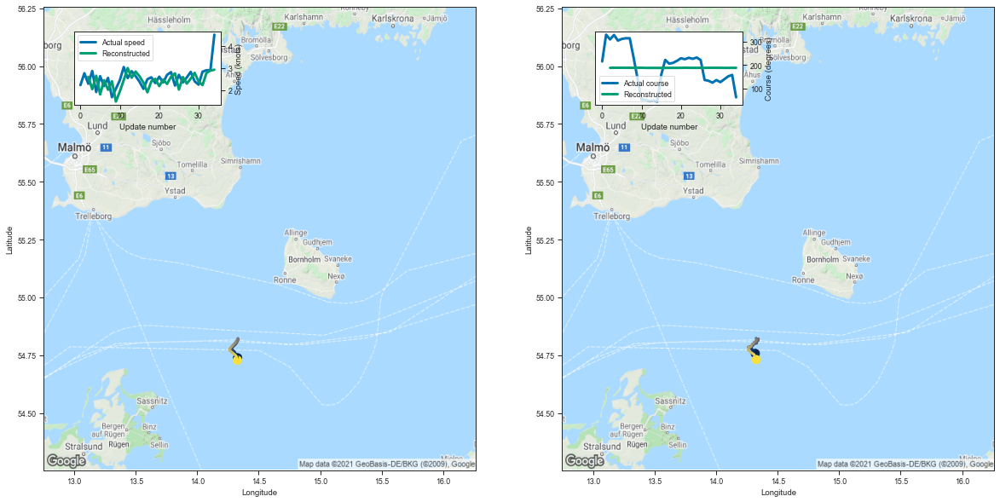

[2.6021273136138916, 2.0477383136749268, 2.651313304901123, 1.8108489513397217]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
43,43,7255864,266054000,Fishing,144,1350.205933,9.376430
26,26,7367080,266054000,Fishing,144,1346.581787,9.351262
57,57,7274400,266054000,Fishing,144,1341.695557,9.317330
1,1,7209524,266054000,Fishing,144,1329.907471,9.235469
105,105,6916021,265759000,Fishing,143,1319.599976,9.227972
...,...,...,...,...,...,...,...
47,47,3662834,261003240,Fishing,142,5.114367,0.036017
52,52,7847175,266315000,Fishing,72,0.621526,0.008632
72,72,5589857,265750000,Fishing,141,-1.726130,-0.012242
56,56,282128,211314800,Fishing,87,-7.400744,-0.085066


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False, validation=validation)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n